#**Zero-Shot Image Restoration Using Denoising Diffusion Null-Space Model**


**DDNM**

The purpose of our project is to reimplement the Denoising Diffusion Null Space Model (DDNM), a novel zero-shot solution for Image Restoration linear problems.
IR aims at yielding an estimation $\hat{x}$ of the original image $x$ from a degradated observation $y$ defined as $y = Ax$, where $x$ stands for the ground truth image and $A$ represents the linear degradation operator.

So, given an input $y$, IR tasks essentially aims to yield an image $\hat{x}$  that conforms to two principles:
* Consistency: $A\hat{x} ≡ y$
* Realness: $\hat{x}\sim q(x)$, where $q(x)$ denotes the distribution of the GT images.

Notice that the GT image $x$ can be decomposed as:
*   Range space part $A^{\dagger}Ax$
*   Null space part $(I-A^{\dagger}A)x$

Indeed if we multiply the range space and the null-space by A, we obtain exactly y for the first and exactly 0 for the second.

$Ax ≡ AA^{\dagger}Ax + (I-A^{\dagger}A)x  ≡ Ax + 0 ≡ y$


By exploiting this observation we can notice that for a degradated image we can directly construct a general solution $\hat{x}= A^{\dagger}y - (I-A^{\dagger}A)\bar{x}$ that satisfies the consistency constraint $A\hat{x} ≡ y$ (whatever $\bar{x}$ is, it does not affect the consistency constraint ). $\bar{x}$ determines wheter $\hat{x} \sim q(x)$, so our goal is to find the proper $\hat{x}$ that makes $\hat{x} \sim q(x)$.

For this scope, we resort to diffusion model.

The reverse diffusion process iteratively samples $x_{t-1}$ from the posterior distribution $p(x_{t-1}|x_{t},x_{0}) = \mathcal{N}(x_{t−1}; \mu_t(x_t, x_0), \sigma_t^2I)$ to yield clean images $x_0 \sim q(x)$ from random noises $x_T \sim \mathcal{N}(0, I)$, where:


*   $\mu_t(x_t, x_0) = \frac{\sqrt{\bar{\alpha}_{t-1}} \beta{t} } {1 - \bar{\alpha}_{t}}x_0 + \frac{\sqrt{\alpha_t} (1-\bar{\alpha}_{t-1}) } {1 - \bar{\alpha}_{t}}x_t$
*   $\sigma_t^2 = \frac{1-\bar{\alpha}_{t-1}}{1-\bar{\alpha}_{t}} \beta_t$
*   $\bar{\alpha_t} = \prod_{i=0}^{t}\alpha_i$
*   $\alpha_t = 1 - \beta_t$
*   $\beta_t$ is the predefined scale factor



We can estimate $x_0$ from $x_t$ and the predicted noise $\epsilon_{t}= Z_\theta(x_{t},t)$, where $Z_\theta$ represents the neural network used for predict the noise $\epsilon$ for each timestep t. We denote the estimated $x_0$ at timestep t as $x_{0|t}$, which can be formulated as:

$$x_{0|t} = \frac{1}{\sqrt{\bar{\alpha_t}}}(x_{t} - Z_\theta(x_{t},t)\sqrt{1-\bar{\alpha_t}})$$


Since our estimated image has to satisfy the consistency constraint, we define a rectified estimation $\hat{x}_{0|t}$ as:

$$\hat{x}_{0|t} = A^{\dagger}y - (I-A^{\dagger}A)x_{0|t} \quad \longrightarrow \quad A\hat{x}_{0|t} ≡ AA^{\dagger}y - A(I-A^{\dagger}A)x_{0|t} ≡ A A^{\dagger} Ax + 0 ≡ Ax ≡ y$$

So we fixed the range space as $A^{\dagger}y$ and we left the null-space unchanged. 
Then, iteratevely we have to apply these three steps to yield a  $x_{0} \sim q(x)$ (considering $x_{0} = \hat{x}_{0|1}$ , so also $x_0$ satisfies the consistency constraint).
All this proposed method is defined as Denoising Diffusion Null-Space Model (DDNM) and its code implemented on pytorch is shown on the ["DDNM"](#scrollTo=-F1omQIW0Asq) section.




**Construction of A and $A^{\dagger}$**

For general tasks of IR the construction of A and its pseudoinverse can be complex, but for the tasks chosen in the paper they can be defined in this way:


*   For the **inpainting** task, A is simply the mask operator and due to unique property AAA ≡ A, it's possible to use $A^{\dagger}$ as A.
*   For what concerns the **colorization** task, A can be a pixel-wise operator $A = [ \frac{1}{3} \frac{1}{3} \frac{1}{3} ]$ that converts each RGB channel pixel into a grayscale value. $A^{\dagger}$ can be $[ 1 1 1 ]^{T}$
that satisfies $AA^{\dagger} = I$.
*   For the **Super Resolution**  with scale n , $A \in \mathbb{R}^{1 x n^2}$ can be the average-pooling operator $A = [ \frac{1}{n^2} \quad ... \quad \frac{1}{n^2} ]$ that averages each patch into a single value. Similarly to previous task, $A^{\dagger} \in \mathbb{R}^{n^2 x 1}$ can be $[ 1 \quad ... \quad  1 ]^{T}$.
*    According to the **Old photo restoration** task, it's possible to decompose the degradation of old photos in three parts, i.e., $A = A_{3}A_{2}A_{1}$, where $A_{3}$ is the average-pooling operator with scale 8, $A_{2}$ is the grayscale operator and $A_{1}$ is the mask operator defined by the damaged areas on the photo.
The pseudo-inverse can be $A^{\dagger}=A^{\dagger}_{1}A^{\dagger}_{2}A^{\dagger}_{3}$.

Its code implemented on pytorch is shown on the ["Implementation of A and its pseudo inverse At"](#scrollTo=AyYAkP85Ji52) section.



**DDNM+**

Since DDNM fails to handle noisy IR tasks, we implemented also an enhanced and robust version of DDNM that is called DDNM+.
In order to handle noisy situations and improve the restoration quality, there have been added two extensions on the DDNM algorithm described above: scaling range-space correction to support noisy image restoration and time-travel for better restoration quality.

*Scaling Range-Space Correction to Support Noisy Image Restoration*

Considering noisy problems in the form of $y = Ax + n$, where $n \sim \mathcal{N}(0, \sigma_y^{2}I)$ (additive Gaussian noise) and $\sigma_y$ denotes the noise variance of  $y$, if we apply directly the DDNM algorithm we obtain:
$\hat{x}_{0|t} = {x}_{0|t} - A^{\dagger}(A{x}_{0|t} - Ax) + A^{\dagger}n$, where $A^{\dagger}n$ is the extra noise introduced into $\hat{x}_{0|t}$.
Then, to handle it we need to modify $\hat{x}_{0|t}$ and $p (x_{t-1}|x_{t},\hat{x}_{0|t})$ defined in the DDNM algorithm as the following:


*     $\hat{x}_{0|t} = {x}_{0|t} - Σ_{t}A^{\dagger}(A{x}_{0|t} - y)$

*     $\hat{p} (x_{t-1}|x_{t},\hat{x}_{0|t})$ = $\mathcal{N}(x_{t−1}; \mu_t(x_t, \hat{x}_{0|t}), \Phi_tI)$

where 
*    $Σ_{t}= λ_{t}I$
*    $Φ_{t}=γ_{t}I$
*    $λ_{t} = \left\{\begin{array}{}
1\quad  \text{if } σ_{t} >= a_{t}σ_{y}\\ 
\frac{σ_{t}}{a_{t}σ_{y}} \quad \text{otherwise}
\end{array}\right.$

* $γ_{t} = σ^2_{t} - (a_{t}λ_{t}σ_{y})^2 $   
*   $a_{t} = \frac{\sqrt{\bar{\alpha}_{t-1}} \beta{t} } {1 - \bar{\alpha}_{t}} $


*Time-Travel For Better Restoration Quality* 

DDNM uses $\hat{x}_{0|t}$ as the estimation of $x_0$ at timestep $t$, but if the range-space contents $A^{\dagger}y$ is too local or uneven, $\hat{x}_{0|t}$ may have disharmonious null-space contents (some cases of inferior realness could be super resolution with large scale and inpainting with a large mask).

We can time travel back to change the past. If we travel back to time-step $t + l$, we can yield the next state $x_{t+l−1}$ using the “future” estimation $\hat{x}_{0|t}$ which should be more accurate than $\hat{x}_{0|t+l}$. This operation
is equivalent to sampling $x_{t+l−1}$ from the forward process $q(x_{t+l−1}|x_{t−1})$ (where $q(x_{t}|x_{0}) = \mathcal{N}(x_t; \sqrt{\bar{\alpha}_{t}}x_0, (1- \bar{\alpha}_{t})I)$).

So we can modify the DDNM algorithm as the following:
for a chosen time-step $t$, we sample $x_{t+l}$ from $q(x_{t+l}|x_t)$. Then we travel back to time-step $t + l$ and repeat normal DDNM sampling until yielding $x_{t−1}$. "l" is the travel length.

With the modified algorithm we can produce a better "past", which consequently produces a better "future".

DDNM+ becomes exactly DDNM when setting $\Sigma_t = I$, $\Phi_t = \sigma_t^2I$ and $l = 0$.

Its code implemented on pytorch is shown on the ["DDNM+"](#scrollTo=N1CuAO3gznOX) section.





# **Libraries to install**

In [ ]:
!pip install torchmetrics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 512.4/512.4 KB 22.4 MB/s eta 0:00:00


In [ ]:
!pip install torch-fidelity

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# **Load the original image**

Here we have defined two functions: the first is used to load the images from a specific path and the second is a composition of transformations to be applied in order to resize and converts the PIL image to a tensor.

In [ ]:
from PIL import Image
def load_image(path):
  img = Image.open(path)
  return img

In [ ]:
from torchvision import transforms as Tran
transforms = Tran.Compose([
    Tran.Resize((256,256)),
    Tran.ToTensor()
])

# **Implementation of A and its pseudo-inverse At**

Choose_task is a function where according to the specific IR task, the two matrices A and its pseudoinverse At are generated.
It is possible to specify some useful parameters like 'scale' or 'mask' depending on the specific task we want to perform.

In [ ]:
# the implementation of this functions is taken from the original paper
def color2gray(x):
    coef=1/3
    x = x[:,0,:,:] * coef + x[:,1,:,:]*coef +  x[:,2,:,:]*coef
    return x.repeat(1,3,1,1)

def gray2color(x):
    x = x[:,0,:,:]
    coef=1/3
    base = coef**2 + coef**2 + coef**2
    return torch.stack((x*coef/base, x*coef/base, x*coef/base), 1)

def PatchUpsample(x, scale):
    n, c, h, w = x.shape
    out = torch.zeros(n, c, h, scale, w, scale).to(x.device) + x.view(n,c,h,1,w,1)
    return out.view(n, c, scale*h, scale*w)


In [ ]:
import torch
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
mask1 = (torch.ones(1,256,256)).to(device)
mask1[0,110:140,63:193] = 0


def choose_task(str,mask=mask1,scale=8):
  if str == 'colorization':
    A = lambda z: color2gray(z)
    At = lambda z: gray2color(z) 
  elif str == 'inpainting':
    A = lambda z: (z.to(device)*mask).to(device)
    At = A
  elif str == 'super resolution':
    A = torch.nn.AdaptiveAvgPool2d((256//scale,256//scale))
    At = lambda z: PatchUpsample(z, scale)
  elif str == 'mask shift trick':
    A = torch.nn.AdaptiveAvgPool2d((64//scale,256//scale))
    At = lambda z: PatchUpsample(z, scale)
  elif str == 'old photo restoration':
    A1 = lambda z: (z.to(device)*mask).to(device)
    A1t = A1
    
    A2 = lambda z: color2gray(z)
    A2t = lambda z: gray2color(z)
    
    A3 = torch.nn.AdaptiveAvgPool2d((256//scale,256//scale))
    A3t = lambda z: PatchUpsample(z,scale)
    
    A = lambda z: A3(A2(A1(z)))
    At = lambda z: A1t(A2t(A3t(z)))
  return A,At



# **DDNM**

Here is shown the DDNM algorithm that takes as input:

*   $y$ ->  degradated image
*   $A$ -> the linear degradation operator
*   $A^{†}$ -> the pseudoinverse of A

and returns $\hat{x}_0$ (the reconstruction of the ground truth image).

In [ ]:
import tqdm
def ddnm(y, A, At):
  with torch.no_grad():
    
    x_t = torch.randn((1,3,256,256)).to(device) # initialize X_T with N(0,1) random gaussian variables
    for t in tqdm.tqdm(range(1000,1,-1)): # T = 1000
      timestep = torch.tensor([t]).to(device)
      x0_t = (1/torch.sqrt(alphas[t-1]) * (x_t -  model(x_t,timestep)[:,0:3,:,:] * torch.sqrt(1-alphas[t-1]))).to(device) # we take the first 3 channels of the ouput
      x0_t_est = (x0_t - At(A(x0_t) - y)).to(device)
      sigma_square = ((1-alphas[t-2]) / (1-alphas[t-1]) * betas[t-1]).to(device)
      eps = torch.randn((1,3,256,256)).to(device) # random noise following gaussian distribution N(0,1)
      x_t = ((torch.sqrt(alphas[t-2]) * betas[t-1] / (1 -alphas[t-1])) * x0_t_est + (torch.sqrt(1-betas[t-1]) * (1-alphas[t-2]) / (1-alphas[t-1])) * x_t + torch.sqrt(sigma_square) * eps).to(device)
  return x_t

# **DDNM+**

Here is shown an enhanced version in order to handle noisy IR tasks. We have implemented the time travel trick with a timestep of 5, since using a bigger number requires a lot of time (even if we have more accurate results).

We have also set the parameter $\sigma_y$ that denotes the noise variance of $y$: the higher $\sigma_y$, the more work the algorithm does to denoise.

In this version we compute at every step $\lambda_{t+j}$ to scale the range-space correction and $\gamma_{t+j}$ to scale the added noise $\sigma_{t+j}$

In [ ]:
import tqdm
def ddnm_plus(y, A, At):
  with torch.no_grad():
    
    x_t = torch.randn((1,3,256,256),dtype=torch.float32).to(device)
    T = 1000
    l = 5 # we chose travel length 5
    sigma_y = 0.1 # sigma_y set to low value
    for t in tqdm.tqdm(range(T,1,-1)):

      L = min(T-t,l)
      eps = torch.randn((1,3,256,256),dtype=torch.float32).to(device)
      x_t_j = (torch.sqrt(alphas[t+L-1]/alphas[t-1])*x_t + torch.sqrt(1-alphas[t+L-1]/alphas[t-1])*eps).to(device)

      for j in range(L,-1,-1):

        a_t_j = (torch.sqrt(alphas[t-2+j])*betas[t-1+j]/(1-alphas[t-1+j])).to(device)
        sigma__t_j_square = ((1-alphas[t-2+j]) / (1-alphas[t-1+j]) * betas[t-1+j]).to(device)

        if torch.sqrt(sigma__t_j_square) >= a_t_j*sigma_y: # compute lambda and gamma according to a_t and sigma_y
          lambda_t_j = (torch.tensor([1],dtype=torch.float32)).to(device)
          gamma_t_j = (sigma__t_j_square - (a_t_j*lambda_t_j*sigma_y)**2).to(device)
        else:
          lambda_t_j = (torch.sqrt(sigma__t_j_square)/(a_t_j*sigma_y)).to(device)
          gamma_t_j = (torch.tensor([0],dtype=torch.float32)).to(device)
        
        
        timestep = torch.tensor([t+j]).to(device)

        x0_t_j = (1/torch.sqrt(alphas[t-1+j]) * (x_t_j -  model(x_t_j,timestep)[:,0:3,:,:] * torch.sqrt(1-alphas[t-1+j]))).to(device)
        x0_t_j_est = (x0_t_j - lambda_t_j*At(A(x0_t_j) - y)).to(device)


        eps = torch.randn((1,3,256,256),dtype=torch.float32).to(device)
        mu_t_j = ((torch.sqrt(alphas[t-2+j]) * betas[t-1+j] / (1 -alphas[t-1+j])) * x0_t_j_est + (torch.sqrt(1-betas[t-1+j]) * (1-alphas[t-2+j]) / (1-alphas[t-1+j])) * x_t_j).to(device)
        x_t_j = ( mu_t_j + torch.sqrt(gamma_t_j) * eps).to(device)

      x_t = x_t_j
  return x_t

# **Evaluation metrics**

Here are shown the three metrics (**PSNR,SSIM,FID**) which we have chosen in order to evaluate the results we have obtained. Every metric takes as input our prediction and the target (the ground truth image). 
PSNR computes Peak Signal-to-Noise Ratio defined as:


**PSNR**(I,J) = 10 * $\log_{10}{\frac{max(I)^2}{MSE(I,J)}}$


**SSIM** is used as a metric to measure the similarity between two given images.The measure between two windows ${\displaystyle x}$ and ${\displaystyle y}$ of common size ${\displaystyle N\times N}$ is


**SSIM**(x,y) = $\frac{(2\mu _{x}\mu _{y}+c_{1})(2\sigma _{xy}+c_{2})}{(\mu _{x}^{2}+\mu _{y}^{2}+c_{1})(\sigma _{x}^{2}+\sigma _{y}^{2}+c_{2})}$


**FID** represents a metric that calculates the distance between feature vectors calculated for real and generated images. The score summarizes how similar the two groups are in terms of statistics on computer vision features of the raw images calculated using the inception v3 model used for image classification. Notice that the lower the score is, the more similar the images are.

**FID** = $|\mu - \mu_w| + tr(\Sigma + \Sigma_w - 2(\Sigma \Sigma_w)^{\frac{1}{2}})$

where $\mathcal{N}(\mu, \Sigma)$ is the multivariate normal distribution estimated from Inception v3 features calculated on real life images and $\mathcal{N}(\mu_w, \Sigma_w)$ is the multivariate normal distribution estimated from Inception v3 features calculated on generated (fake) images

In [ ]:
from torchmetrics import PeakSignalNoiseRatio
# take as input 3 dimension tensors
def pnsr(prediction,target):
  psnr = PeakSignalNoiseRatio()
  return psnr(prediction,target)

In [ ]:
from torchmetrics import StructuralSimilarityIndexMeasure
# take as input 4 dimension tensors
def ssim(prediction,target):
  ssim = StructuralSimilarityIndexMeasure()
  return ssim(prediction, target)

In [ ]:
from torchmetrics.image.fid import FrechetInceptionDistance
# take as input 4 dimension tensors and the first dimension that represent the batch size has to be greater than 1
def fid(prediction,target):
  fid = FrechetInceptionDistance(feature = 64,normalize=True)
  fid.update(target, real=True)
  fid.update(prediction, real=False)
  return fid.compute()

# **CelebA**

Here is shown the ground truth image that we have used in our experiments.

In [ ]:
!wget https://raw.githubusercontent.com/cesto99/NNProject/91ac7d129c242a3233905a5abf833305b6c19f8a/images_for_evaluation/woman_3.png

--2023-01-10 18:33:20--  https://raw.githubusercontent.com/cesto99/NNProject/91ac7d129c242a3233905a5abf833305b6c19f8a/images_for_evaluation/woman_3.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1742264 (1.7M) [image/png]
Saving to: ‘woman_3.png’

woman_3.png         100%[===================>]   1.66M  --.-KB/s    in 0.02s   

2023-01-10 18:33:20 (82.3 MB/s) - ‘woman_3.png’ saved [1742264/1742264]



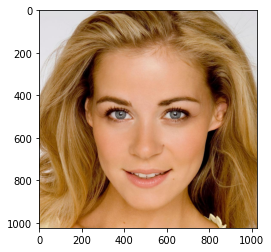

In [ ]:
import matplotlib.pyplot as plt
path_celeba ="woman_3.png"
img = load_image(path_celeba)
plt.imshow(img)

## **Pre-trained Model CelebA**

We have taken the structure of the diffusion model from https://github.com/wyhuai/DDNM/blob/main/guided_diffusion/models.py, then we have loaded the file .ckpt into the model to get a pretrained version ready to use.

In [ ]:
!wget https://image-editing-test-12345.s3-us-west-2.amazonaws.com/checkpoints/celeba_hq.ckpt

--2023-01-07 10:53:44--  https://image-editing-test-12345.s3-us-west-2.amazonaws.com/checkpoints/celeba_hq.ckpt
Resolving image-editing-test-12345.s3-us-west-2.amazonaws.com (image-editing-test-12345.s3-us-west-2.amazonaws.com)... 52.92.195.234, 52.92.163.138, 52.92.213.26, ...
Connecting to image-editing-test-12345.s3-us-west-2.amazonaws.com (image-editing-test-12345.s3-us-west-2.amazonaws.com)|52.92.195.234|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 454777119 (434M) [application/x-www-form-urlencoded]
Saving to: ‘celeba_hq.ckpt’

celeba_hq.ckpt      100%[===================>] 433.71M  47.7MB/s    in 9.6s    

2023-01-07 10:53:53 (45.2 MB/s) - ‘celeba_hq.ckpt’ saved [454777119/454777119]



In [ ]:
import torch
checkpoint1 = torch.load("celeba_hq.ckpt")

In [ ]:
import math
import torch
import torch.nn as nn

def get_timestep_embedding(timesteps, embedding_dim):
  assert len(timesteps.shape) == 1
  
  half_dim = embedding_dim // 2
  emb = math.log(10000) / (half_dim - 1)
  emb = torch.exp(torch.arange(half_dim, dtype=torch.float32) * -emb)
  emb = emb.to(device=timesteps.device)
  emb = timesteps.float()[:, None] * emb[None, :]
  emb = torch.cat([torch.sin(emb), torch.cos(emb)], dim=1)
  if embedding_dim % 2 == 1:  # zero pad
    emb = torch.nn.functional.pad(emb, (0, 1, 0, 0))
  return emb

In [ ]:
def nonlinearity(x):
  return x*torch.sigmoid(x)

def Normalize(in_channels):
  return torch.nn.GroupNorm(num_groups=32, num_channels=in_channels, eps=1e-6, affine=True)

In [ ]:
class Upsample(nn.Module):
  def __init__(self, in_channels, with_conv):
    super().__init__()
    self.with_conv = with_conv
    if self.with_conv:
      self.conv = torch.nn.Conv2d(in_channels,in_channels,kernel_size=3,stride=1,padding=1)
  
  def forward(self, x):
    x = torch.nn.functional.interpolate(x, scale_factor=2.0, mode="nearest")
    if self.with_conv:
      x = self.conv(x)
    return x

In [ ]:
class ResnetBlock(nn.Module):
  def __init__(self, *, in_channels, out_channels=None, conv_shortcut=False,dropout, temb_channels=512):
    super().__init__()
    self.in_channels = in_channels
    out_channels = in_channels if out_channels is None else out_channels
    self.out_channels = out_channels
    self.use_conv_shortcut = conv_shortcut

    self.norm1 = Normalize(in_channels)
    self.conv1 = torch.nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
    self.temb_proj = torch.nn.Linear(temb_channels, out_channels)
    self.norm2 = Normalize(out_channels)
    self.dropout = torch.nn.Dropout(dropout)
    self.conv2 = torch.nn.Conv2d(out_channels,out_channels, kernel_size=3, stride=1, padding=1)
    if self.in_channels != self.out_channels:
      if self.use_conv_shortcut:
        self.conv_shortcut = torch.nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
      else:
        self.nin_shortcut = torch.nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1, padding=0)

  def forward(self, x, temb):
    h = x
    h = self.norm1(h)
    h = nonlinearity(h)
    h = self.conv1(h)

    h = h + self.temb_proj(nonlinearity(temb))[:, :, None, None]

    h = self.norm2(h)
    h = nonlinearity(h)
    h = self.dropout(h)
    h = self.conv2(h)

    if self.in_channels != self.out_channels:
      if self.use_conv_shortcut:
        x = self.conv_shortcut(x)
      else:
        x = self.nin_shortcut(x)

    return x+h


In [ ]:
class AttnBlock(nn.Module):
  def __init__(self, in_channels):
    super().__init__()
    self.in_channels = in_channels

    self.norm = Normalize(in_channels)
    self.q = torch.nn.Conv2d(in_channels, in_channels, kernel_size=1,stride=1, padding=0)
    self.k = torch.nn.Conv2d(in_channels,in_channels, kernel_size=1,stride=1, padding=0)
    self.v = torch.nn.Conv2d(in_channels, in_channels,kernel_size=1,stride=1, padding=0)
    self.proj_out = torch.nn.Conv2d(in_channels,in_channels,kernel_size=1,stride=1,padding=0)

  def forward(self, x):
    h_ = x
    h_ = self.norm(h_)
    q = self.q(h_)
    k = self.k(h_)
    v = self.v(h_)

    # compute attention
    b, c, h, w = q.shape
    q = q.reshape(b, c, h*w)
    q = q.permute(0, 2, 1)   # b,hw,c
    k = k.reshape(b, c, h*w)  # b,c,hw
    w_ = torch.bmm(q, k)     # b,hw,hw    w[b,i,j]=sum_c q[b,i,c]k[b,c,j]
    w_ = w_ * (int(c)**(-0.5))
    w_ = torch.nn.functional.softmax(w_, dim=2)

    # attend to values
    v = v.reshape(b, c, h*w)
    w_ = w_.permute(0, 2, 1)   # b,hw,hw (first hw of k, second of q)
    # b, c,hw (hw of q) h_[b,c,j] = sum_i v[b,c,i] w_[b,i,j]
    h_ = torch.bmm(v, w_)
    h_ = h_.reshape(b, c, h, w)

    h_ = self.proj_out(h_)

    return x+h_



In [ ]:
class Downsample(nn.Module):
  def __init__(self, in_channels, with_conv):
    super().__init__()
    self.with_conv = with_conv
    if self.with_conv:
      self.conv = torch.nn.Conv2d(in_channels, in_channels,kernel_size=3,stride=2,padding=0)

  def forward(self, x):
    if self.with_conv:
      pad = (0, 1, 0, 1)
      x = torch.nn.functional.pad(x, pad, mode="constant", value=0)
      x = self.conv(x)
    else:
      x = torch.nn.functional.avg_pool2d(x, kernel_size=2, stride=2)
    return x



In [ ]:
class Model(nn.Module):
  def __init__(self):
    super().__init__()
# celeba
    ch = 128
    out_ch = 3
    ch_mult = (1,1,2,2,4,4)
    num_res_blocks = 2
    attn_resolutions = (16, )
    dropout = 0.0
    in_channels = 3
    resolution = 256
    resamp_with_conv = True
    num_timesteps = 1000

    self.ch = ch
    self.temb_ch = self.ch*4
    self.num_resolutions = len(ch_mult)
    self.num_res_blocks = num_res_blocks
    self.resolution = resolution
    self.in_channels = in_channels

    # timestep embedding
    self.temb = nn.Module()
    self.temb.dense = nn.ModuleList([torch.nn.Linear(self.ch,self.temb_ch),torch.nn.Linear(self.temb_ch,self.temb_ch),])

    # downsampling
    self.conv_in = torch.nn.Conv2d(in_channels,self.ch, kernel_size=3,stride=1,padding=1)

    curr_res = resolution
    in_ch_mult = (1,)+ch_mult
    self.down = nn.ModuleList()
    block_in = None
    for i_level in range(self.num_resolutions):
      block = nn.ModuleList()
      attn = nn.ModuleList()
      block_in = ch*in_ch_mult[i_level]
      block_out = ch*ch_mult[i_level]
      for i_block in range(self.num_res_blocks):
        block.append(ResnetBlock(in_channels=block_in,out_channels=block_out,temb_channels=self.temb_ch,dropout=dropout))
        block_in = block_out
        if curr_res in attn_resolutions:
          attn.append(AttnBlock(block_in))
      down = nn.Module()
      down.block = block
      down.attn = attn
      if i_level != self.num_resolutions-1:
        down.downsample = Downsample(block_in, resamp_with_conv)
        curr_res = curr_res // 2
      self.down.append(down)

    # middle
    self.mid = nn.Module()
    self.mid.block_1 = ResnetBlock(in_channels=block_in, out_channels=block_in, temb_channels=self.temb_ch, dropout=dropout)
    self.mid.attn_1 = AttnBlock(block_in)
    self.mid.block_2 = ResnetBlock(in_channels=block_in, out_channels=block_in, temb_channels=self.temb_ch, dropout=dropout)

    # upsampling
    self.up = nn.ModuleList()
    for i_level in reversed(range(self.num_resolutions)):
      block = nn.ModuleList()
      attn = nn.ModuleList()
      block_out = ch*ch_mult[i_level]
      skip_in = ch*ch_mult[i_level]
      for i_block in range(self.num_res_blocks+1):
        if i_block == self.num_res_blocks:
          skip_in = ch*in_ch_mult[i_level]
        block.append(ResnetBlock(in_channels=block_in+skip_in, out_channels=block_out,temb_channels=self.temb_ch, dropout=dropout))
        block_in = block_out
        if curr_res in attn_resolutions:
          attn.append(AttnBlock(block_in))
      up = nn.Module()
      up.block = block
      up.attn = attn
      if i_level != 0:
        up.upsample = Upsample(block_in, resamp_with_conv)
        curr_res = curr_res * 2
      self.up.insert(0, up) 

    # end
    self.norm_out = Normalize(block_in)
    self.conv_out = torch.nn.Conv2d(block_in, out_ch, kernel_size=3, stride=1, padding=1)

  def forward(self, x, t):
    assert x.shape[2] == x.shape[3] == self.resolution

    # timestep embedding
    temb = get_timestep_embedding(t, self.ch)
    temb = self.temb.dense[0](temb)
    temb = nonlinearity(temb)
    temb = self.temb.dense[1](temb)

    # downsampling
    hs = [self.conv_in(x)]
    for i_level in range(self.num_resolutions):
      for i_block in range(self.num_res_blocks):
        h = self.down[i_level].block[i_block](hs[-1], temb)
        if len(self.down[i_level].attn) > 0:
          h = self.down[i_level].attn[i_block](h)
        hs.append(h)
      if i_level != self.num_resolutions-1:
        hs.append(self.down[i_level].downsample(hs[-1]))

    # middle
    h = hs[-1]
    h = self.mid.block_1(h, temb)
    h = self.mid.attn_1(h)
    h = self.mid.block_2(h, temb)

    # upsampling
    for i_level in reversed(range(self.num_resolutions)):
      for i_block in range(self.num_res_blocks+1):
        h = self.up[i_level].block[i_block](torch.cat([h, hs.pop()], dim=1), temb)
        if len(self.up[i_level].attn) > 0:
          h = self.up[i_level].attn[i_block](h)
      if i_level != 0:
        h = self.up[i_level].upsample(h)

    # end
    h = self.norm_out(h)
    h = nonlinearity(h)
    h = self.conv_out(h)
    return h

In [ ]:
model = Model().to(device)
model.load_state_dict(checkpoint1)

<All keys matched successfully>

Here we defined the betas and alphas parameters which will be used in the two algorithms.

In [ ]:
import numpy as np
# definition of beta factors depends on the model, we have created 1000 factors, one for each timestep
betas = torch.tensor(np.linspace(0.0001, 0.02, 1000, dtype=np.float64)).to(device)
#alphas bar
alphas = torch.cumprod(1 - betas, dim=0).to(device)

## **Colorization**

Initialization of A, At and y according to the *Colorization* task.
Notice that y=Ax, where x is the ground truth image and  *transforms* applies the composition of transformations described in 'Load the original image' section. 
The unsqueeze functions adds dimension of size one inserted at the specified position(0) because the two algorithms requires a tensor of four dimensions.

In [ ]:
A,At = choose_task("colorization")
y = (A(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Here is applied the DDNM algorithm for the colorization task and then the result is shown in the last picture. Notice that the degradated image is generated from the application of the linear degradation operator on the ground truth image.

In [ ]:
x0_col = ddnm(y, A, At)

100%|██████████| 999/999 [02:19<00:00,  7.18it/s]


Text(0.5, 1.0, 'restored image using ddnm')

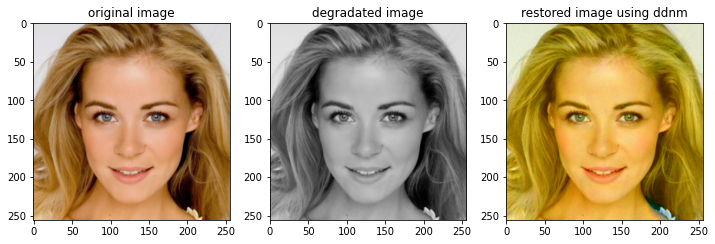

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_col[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




#### Evaluation

As highlighted in the paper, since PSNR and SSIM can not reflect the colorization performance, for this task we have adopted only the FID metric.

In [ ]:
FID = fid(x0_col.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
FID

Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth


  0%|          | 0.00/91.2M [00:00<?, ?B/s]

/usr/local/lib/python3.8/dist-packages/scipy/linalg/_matfuncs_sqrtm.py:186: RuntimeWarning: invalid value encountered in double_scalars
  arg2 = norm(X.dot(X) - A, 'fro')**2 / norm(A, 'fro')


tensor(32.1061)

### DDNM+

Here is applied the DDNM+ algorithm for the colorization task.

In [ ]:
x0_col_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [13:13<00:00,  1.26it/s]


Text(0.5, 1.0, 'restored image using ddnm+')

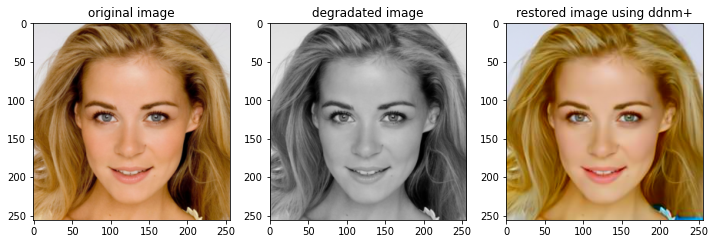

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_col_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on Colorization task for FID metric

In [ ]:
FID = fid(x0_col_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
FID

tensor(14.0075)

## **Inpainting**

Initialization of A, At and y according to the *Inpainting* task

In [ ]:
A,At = choose_task("inpainting")
y = (A(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Application of the DDNM algorithm on the degradated image for the *inpainting* task

In [ ]:
x0_inp = ddnm(y, A, At)

100%|██████████| 999/999 [02:13<00:00,  7.50it/s]


Text(0.5, 1.0, 'restored image using ddnm')

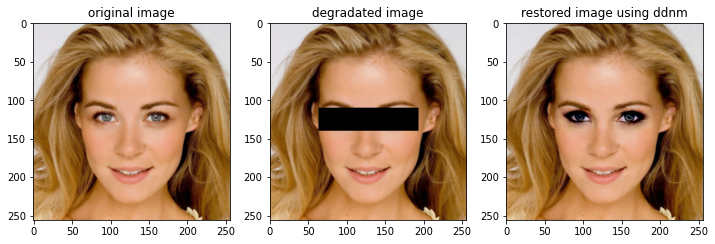

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_inp[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




#### Evaluation

DDNM performance on *Inpainting* task for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_inp[0].cpu(),transforms(img))
SSIM = ssim(x0_inp.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_inp.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(25.8045), tensor(0.9498), tensor(1.9696))

### DDNM+

Application of DDNM+ algorithm for the inpainting task

In [ ]:
x0_inp_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [13:12<00:00,  1.26it/s]


Text(0.5, 1.0, 'restored image using ddnm+')

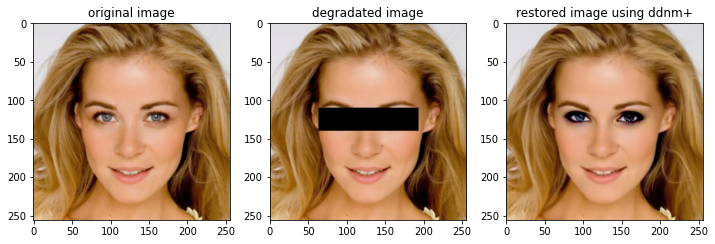

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_inp_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on *Inpainting* task for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_inp_plus[0].cpu(),transforms(img))
SSIM = ssim(x0_inp_plus.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_inp_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(26.6157), tensor(0.9432), tensor(1.3672))

## **Super Resolution**

Initialization of A, At and y according to the *Super resolution* task.  We performed the task using two different values of the parameter scale

In [ ]:
#variables to perform super resolution using the parameter scale equal to 16
A,At = choose_task("super resolution",scale=16)
y = (A(transforms(img).unsqueeze(0))).to(device)

#variables to perform super resolution using the parameter scale equal to 8
A1,At1 = choose_task("super resolution",scale=8)
y1 = (A1(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Application of the DDNM algorithm on the degradated image for the *Super Resolution* task using a scale equal to 16

In [ ]:
x0_sr = ddnm(y, A, At)

100%|██████████| 999/999 [02:14<00:00,  7.44it/s]


Text(0.5, 1.0, 'restored image using ddnm')

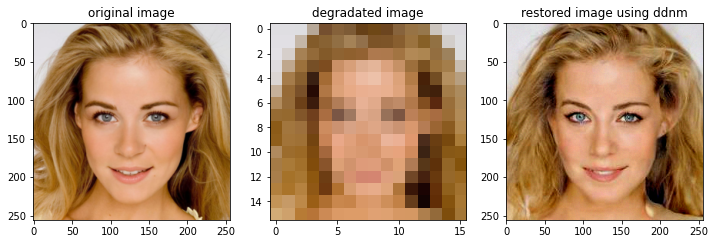

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




Application of the DDNM algorithm on the degradated image for the *Super Resolution* task using a scale equal to 8

In [ ]:
x0_sr1 = ddnm(y1, A1, At1)

100%|██████████| 999/999 [02:30<00:00,  6.66it/s]


Text(0.5, 1.0, 'restored image using ddnm')

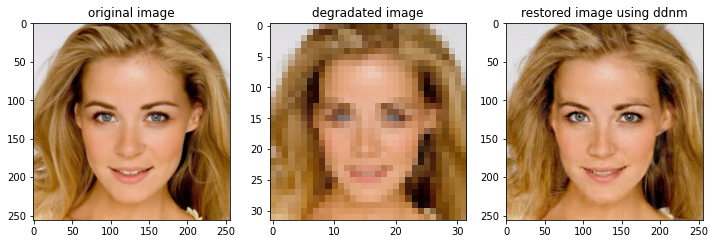

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y1[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr1[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 

#### Evaluation

DDNM performance on *Super resolution* task (using a scale equal to 16)  for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_sr[0].cpu(),transforms(img))
SSIM = ssim(x0_sr.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_sr.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(19.9751), tensor(0.5554), tensor(9.8731))

DDNM performance on *Super resolution* task (using a scale equal to 8)  for PSNR,SSIM and FID metric

In [ ]:
PNSR1 = pnsr(x0_sr1[0].cpu(),transforms(img))
SSIM1 = ssim(x0_sr1.cpu(),transforms(img).unsqueeze(0))
FID1 = fid(x0_sr1.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR1,SSIM1,FID1

(tensor(23.5261), tensor(0.6442), tensor(7.9429))

### DDNM+

Application of the DDNM+ algorithm on the degradated image for the *Super Resolution* task using a scale equal to 16

In [ ]:
x0_sr_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [13:18<00:00,  1.25it/s]


Text(0.5, 1.0, 'restored image using ddnm+')

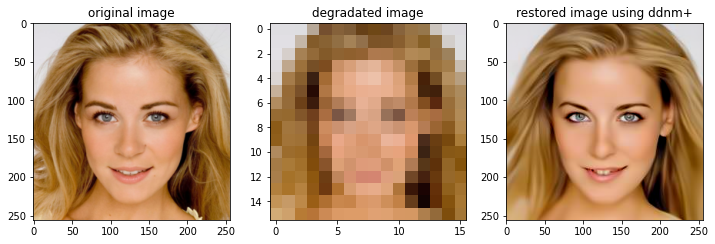

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

Application of the DDNM+ algorithm on the degradated image for the *Super Resolution* task using a scale equal to 8

In [ ]:
x0_sr1_plus = ddnm_plus(y1, A1, At1)

100%|██████████| 999/999 [14:07<00:00,  1.18it/s]


Text(0.5, 1.0, 'restored image using ddnm+')

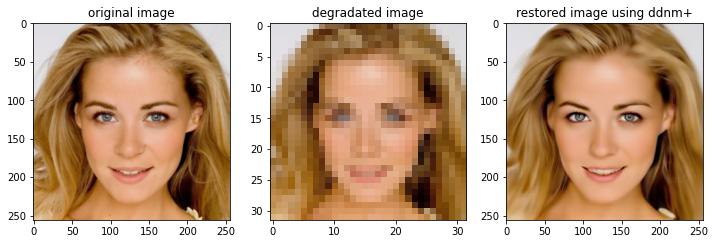

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y1[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr1_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on *Super resolution* task (using a scale equal to 16)  for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_sr_plus[0].cpu(),transforms(img))
SSIM = ssim(x0_sr_plus.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_sr_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(21.1639), tensor(0.6444), tensor(3.8902))

DDNM+ performance on *Super resolution* task (using a scale equal to 8)  for PSNR,SSIM and FID metric

In [ ]:
PNSR1 = pnsr(x0_sr1_plus[0].cpu(),transforms(img))
SSIM1 = ssim(x0_sr1_plus.cpu(),transforms(img).unsqueeze(0))
FID1 = fid(x0_sr1_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR1,SSIM1,FID1

(tensor(24.9730), tensor(0.7406), tensor(4.4710))

## **Old Photo Restoration**

Initialization of A, At and y according to the *Old Photo Restoration* task.

In [ ]:
A,At = choose_task("old photo restoration")
y = (A(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Application of the DDNM algorithm on the degradated image for the *Old Photo Restoration* task

In [ ]:
x0_old = ddnm(y, A, At)

100%|██████████| 999/999 [02:14<00:00,  7.43it/s]


Text(0.5, 1.0, 'restored image using ddnm')

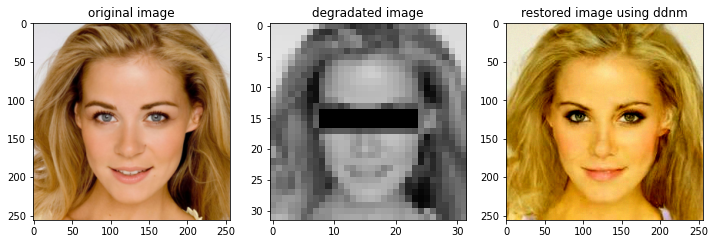

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_old[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




#### Evaluation

DDNM performance on *Old Photo Restoration* task (using a scale equal to 8)  for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_old[0].cpu(),transforms(img))
SSIM = ssim(x0_old.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_old.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(16.6642), tensor(0.5799), tensor(50.7092))

### DDNM+

Application of the DDNM+ algorithm on the degradated image for the *Old Photo Restoration* task

In [ ]:
x0_old_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [13:19<00:00,  1.25it/s]


Text(0.5, 1.0, 'restored image using ddnm+')

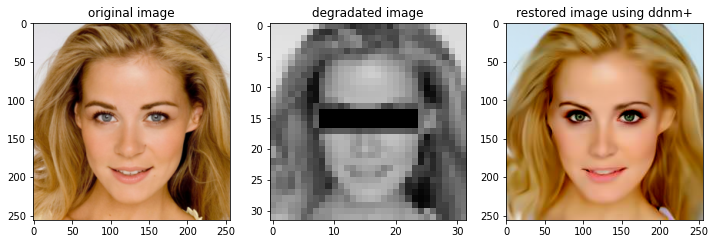

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_old_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on *Old Photo Restoration* task (using a scale equal to 8)  for PSNR, SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_old_plus[0].cpu(),transforms(img))
SSIM = ssim(x0_old_plus.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_old_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(20.0681), tensor(0.7116), tensor(11.9682))

# **ImageNet**

Ground truth image

In [ ]:
!wget https://raw.githubusercontent.com/cesto99/NNProject/91ac7d129c242a3233905a5abf833305b6c19f8a/images_for_evaluation/squirrel.png

--2023-01-10 18:34:21--  https://raw.githubusercontent.com/cesto99/NNProject/91ac7d129c242a3233905a5abf833305b6c19f8a/images_for_evaluation/squirrel.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 281011 (274K) [image/png]
Saving to: ‘squirrel.png’

squirrel.png        100%[===================>] 274.42K  --.-KB/s    in 0.01s   

2023-01-10 18:34:22 (24.0 MB/s) - ‘squirrel.png’ saved [281011/281011]



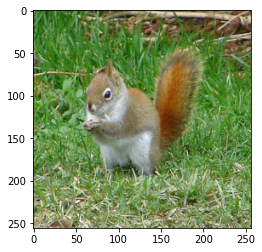

In [ ]:
import matplotlib.pyplot as plt
path_imagenet = "squirrel.png"
img = load_image(path_imagenet)
plt.imshow(transforms(img).permute(1,2,0))

## **Pre-trained Model ImageNet**

We have taken the structure of the diffusion model from https://github.com/wyhuai/DDNM/blob/main/guided_diffusion/unet.py, then we have loaded the file .ckpt into the model to get a pretrained version ready to use.

In [ ]:
!wget https://openaipublic.blob.core.windows.net/diffusion/jul-2021/256x256_diffusion_uncond.pt

--2023-01-07 13:11:24--  https://openaipublic.blob.core.windows.net/diffusion/jul-2021/256x256_diffusion_uncond.pt
Resolving openaipublic.blob.core.windows.net (openaipublic.blob.core.windows.net)... 20.150.77.132
Connecting to openaipublic.blob.core.windows.net (openaipublic.blob.core.windows.net)|20.150.77.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2211383297 (2.1G) [application/octet-stream]
Saving to: ‘256x256_diffusion_uncond.pt’

256x256_diffusion_u 100%[===================>]   2.06G  26.2MB/s    in 83s     

2023-01-07 13:12:47 (25.4 MB/s) - ‘256x256_diffusion_uncond.pt’ saved [2211383297/2211383297]



In [ ]:
import torch
checkpoint2 = torch.load("256x256_diffusion_uncond.pt")

In [ ]:
import math

import torch as th
import torch.nn as nn


# PyTorch 1.7 has SiLU, but we support PyTorch 1.5.
class SiLU(nn.Module):
    def forward(self, x):
        return x * th.sigmoid(x)


class GroupNorm32(nn.GroupNorm):
    def forward(self, x):
        return super().forward(x.float()).type(x.dtype)


def conv_nd(dims, *args, **kwargs):
    """
    Create a 1D, 2D, or 3D convolution module.
    """
    if dims == 1:
        return nn.Conv1d(*args, **kwargs)
    elif dims == 2:
        return nn.Conv2d(*args, **kwargs)
    elif dims == 3:
        return nn.Conv3d(*args, **kwargs)
    raise ValueError(f"unsupported dimensions: {dims}")


def linear(*args, **kwargs):
    """
    Create a linear module.
    """
    return nn.Linear(*args, **kwargs)


def avg_pool_nd(dims, *args, **kwargs):
    """
    Create a 1D, 2D, or 3D average pooling module.
    """
    if dims == 1:
        return nn.AvgPool1d(*args, **kwargs)
    elif dims == 2:
        return nn.AvgPool2d(*args, **kwargs)
    elif dims == 3:
        return nn.AvgPool3d(*args, **kwargs)
    raise ValueError(f"unsupported dimensions: {dims}")


def update_ema(target_params, source_params, rate=0.99):
    """
    Update target parameters to be closer to those of source parameters using
    an exponential moving average.
    :param target_params: the target parameter sequence.
    :param source_params: the source parameter sequence.
    :param rate: the EMA rate (closer to 1 means slower).
    """
    for targ, src in zip(target_params, source_params):
        targ.detach().mul_(rate).add_(src, alpha=1 - rate)


def zero_module(module):
    """
    Zero out the parameters of a module and return it.
    """
    for p in module.parameters():
        p.detach().zero_()
    return module


def scale_module(module, scale):
    """
    Scale the parameters of a module and return it.
    """
    for p in module.parameters():
        p.detach().mul_(scale)
    return module


def mean_flat(tensor):
    """
    Take the mean over all non-batch dimensions.
    """
    return tensor.mean(dim=list(range(1, len(tensor.shape))))


def normalization(channels):
    """
    Make a standard normalization layer.
    :param channels: number of input channels.
    :return: an nn.Module for normalization.
    """
    return GroupNorm32(32, channels)


def timestep_embedding(timesteps, dim, max_period=10000):
    """
    Create sinusoidal timestep embeddings.
    :param timesteps: a 1-D Tensor of N indices, one per batch element.
                      These may be fractional.
    :param dim: the dimension of the output.
    :param max_period: controls the minimum frequency of the embeddings.
    :return: an [N x dim] Tensor of positional embeddings.
    """
    half = dim // 2
    freqs = th.exp(
        -math.log(max_period) * th.arange(start=0, end=half, dtype=th.float32) / half
    ).to(device=timesteps.device)
    args = timesteps[:, None].float() * freqs[None]
    embedding = th.cat([th.cos(args), th.sin(args)], dim=-1)
    if dim % 2:
        embedding = th.cat([embedding, th.zeros_like(embedding[:, :1])], dim=-1)
    return embedding


def checkpoint(func, inputs, params, flag):
    """
    Evaluate a function without caching intermediate activations, allowing for
    reduced memory at the expense of extra compute in the backward pass.
    :param func: the function to evaluate.
    :param inputs: the argument sequence to pass to `func`.
    :param params: a sequence of parameters `func` depends on but does not
                   explicitly take as arguments.
    :param flag: if False, disable gradient checkpointing.
    """
    if flag:
        args = tuple(inputs) + tuple(params)
        return CheckpointFunction.apply(func, len(inputs), *args)
    else:
        return func(*inputs)


class CheckpointFunction(th.autograd.Function):
    @staticmethod
    def forward(ctx, run_function, length, *args):
        ctx.run_function = run_function
        ctx.input_tensors = list(args[:length])
        ctx.input_params = list(args[length:])
        with th.no_grad():
            output_tensors = ctx.run_function(*ctx.input_tensors)
        return output_tensors

    @staticmethod
    def backward(ctx, *output_grads):
        ctx.input_tensors = [x.detach().requires_grad_(True) for x in ctx.input_tensors]
        with th.enable_grad():
            # Fixes a bug where the first op in run_function modifies the
            # Tensor storage in place, which is not allowed for detach()'d
            # Tensors.
            shallow_copies = [x.view_as(x) for x in ctx.input_tensors]
            output_tensors = ctx.run_function(*shallow_copies)
        input_grads = th.autograd.grad(
            output_tensors,
            ctx.input_tensors + ctx.input_params,
            output_grads,
            allow_unused=True,
        )
        del ctx.input_tensors
        del ctx.input_params
        del output_tensors
        return (None, None) + input_grads

def convert_module_to_f16(l):
    """
    Convert primitive modules to float16.
    """
    if isinstance(l, (nn.Conv1d, nn.Conv2d, nn.Conv3d)):
        l.weight.data = l.weight.data.half()
        if l.bias is not None:
            l.bias.data = l.bias.data.half()


def convert_module_to_f32(l):
    """
    Convert primitive modules to float32, undoing convert_module_to_f16().
    """
    if isinstance(l, (nn.Conv1d, nn.Conv2d, nn.Conv3d)):
        l.weight.data = l.weight.data.float()
        if l.bias is not None:
            l.bias.data = l.bias.data.float()

In [ ]:
from abc import abstractmethod

import math

import numpy as np
import torch as th
import torch.nn as nn
import torch.nn.functional as F

class AttentionPool2d(nn.Module):
    """
    Adapted from CLIP: https://github.com/openai/CLIP/blob/main/clip/model.py
    """

    def __init__(
        self,
        spacial_dim: int,
        embed_dim: int,
        num_heads_channels: int,
        output_dim: int = None,
    ):
        super().__init__()
        self.positional_embedding = nn.Parameter(
            th.randn(embed_dim, spacial_dim ** 2 + 1) / embed_dim ** 0.5
        )
        self.qkv_proj = conv_nd(1, embed_dim, 3 * embed_dim, 1)
        self.c_proj = conv_nd(1, embed_dim, output_dim or embed_dim, 1)
        self.num_heads = embed_dim // num_heads_channels
        self.attention = QKVAttention(self.num_heads)

    def forward(self, x):
        b, c, *_spatial = x.shape
        x = x.reshape(b, c, -1)  # NC(HW)
        x = th.cat([x.mean(dim=-1, keepdim=True), x], dim=-1)  # NC(HW+1)
        x = x + self.positional_embedding[None, :, :].to(x.dtype)  # NC(HW+1)
        x = self.qkv_proj(x)
        x = self.attention(x)
        x = self.c_proj(x)
        return x[:, :, 0]


class TimestepBlock(nn.Module):
    """
    Any module where forward() takes timestep embeddings as a second argument.
    """

    @abstractmethod
    def forward(self, x, emb):
        """
        Apply the module to `x` given `emb` timestep embeddings.
        """


class TimestepEmbedSequential(nn.Sequential, TimestepBlock):
    """
    A sequential module that passes timestep embeddings to the children that
    support it as an extra input.
    """

    def forward(self, x, emb):
        for layer in self:
            if isinstance(layer, TimestepBlock):
                x = layer(x, emb)
            else:
                x = layer(x)
        return x


class Upsample(nn.Module):
    """
    An upsampling layer with an optional convolution.
    :param channels: channels in the inputs and outputs.
    :param use_conv: a bool determining if a convolution is applied.
    :param dims: determines if the signal is 1D, 2D, or 3D. If 3D, then
                 upsampling occurs in the inner-two dimensions.
    """

    def __init__(self, channels, use_conv, dims=2, out_channels=None):
        super().__init__()
        self.channels = channels
        self.out_channels = out_channels or channels
        self.use_conv = use_conv
        self.dims = dims
        if use_conv:
            self.conv = conv_nd(dims, self.channels, self.out_channels, 3, padding=1)

    def forward(self, x):
        assert x.shape[1] == self.channels
        if self.dims == 3:
            x = F.interpolate(
                x, (x.shape[2], x.shape[3] * 2, x.shape[4] * 2), mode="nearest"
            )
        else:
            x = F.interpolate(x, scale_factor=2, mode="nearest")
        if self.use_conv:
            x = self.conv(x)
        return x


class Downsample(nn.Module):
    """
    A downsampling layer with an optional convolution.
    :param channels: channels in the inputs and outputs.
    :param use_conv: a bool determining if a convolution is applied.
    :param dims: determines if the signal is 1D, 2D, or 3D. If 3D, then
                 downsampling occurs in the inner-two dimensions.
    """

    def __init__(self, channels, use_conv, dims=2, out_channels=None):
        super().__init__()
        self.channels = channels
        self.out_channels = out_channels or channels
        self.use_conv = use_conv
        self.dims = dims
        stride = 2 if dims != 3 else (1, 2, 2)
        if use_conv:
            self.op = conv_nd(
                dims, self.channels, self.out_channels, 3, stride=stride, padding=1
            )
        else:
            assert self.channels == self.out_channels
            self.op = avg_pool_nd(dims, kernel_size=stride, stride=stride)

    def forward(self, x):
        assert x.shape[1] == self.channels
        return self.op(x)


class ResBlock(TimestepBlock):
    """
    A residual block that can optionally change the number of channels.
    :param channels: the number of input channels.
    :param emb_channels: the number of timestep embedding channels.
    :param dropout: the rate of dropout.
    :param out_channels: if specified, the number of out channels.
    :param use_conv: if True and out_channels is specified, use a spatial
        convolution instead of a smaller 1x1 convolution to change the
        channels in the skip connection.
    :param dims: determines if the signal is 1D, 2D, or 3D.
    :param use_checkpoint: if True, use gradient checkpointing on this module.
    :param up: if True, use this block for upsampling.
    :param down: if True, use this block for downsampling.
    """

    def __init__(
        self,
        channels,
        emb_channels,
        dropout,
        out_channels=None,
        use_conv=False,
        use_scale_shift_norm=False,
        dims=2,
        use_checkpoint=False,
        up=False,
        down=False,
    ):
        super().__init__()
        self.channels = channels
        self.emb_channels = emb_channels
        self.dropout = dropout
        self.out_channels = out_channels or channels
        self.use_conv = use_conv
        self.use_checkpoint = use_checkpoint
        self.use_scale_shift_norm = use_scale_shift_norm

        self.in_layers = nn.Sequential(
            normalization(channels),
            nn.SiLU(),
            conv_nd(dims, channels, self.out_channels, 3, padding=1),
        )

        self.updown = up or down

        if up:
            self.h_upd = Upsample(channels, False, dims)
            self.x_upd = Upsample(channels, False, dims)
        elif down:
            self.h_upd = Downsample(channels, False, dims)
            self.x_upd = Downsample(channels, False, dims)
        else:
            self.h_upd = self.x_upd = nn.Identity()

        self.emb_layers = nn.Sequential(
            nn.SiLU(),
            linear(
                emb_channels,
                2 * self.out_channels if use_scale_shift_norm else self.out_channels,
            ),
        )
        self.out_layers = nn.Sequential(
            normalization(self.out_channels),
            nn.SiLU(),
            nn.Dropout(p=dropout),
            zero_module(
                conv_nd(dims, self.out_channels, self.out_channels, 3, padding=1)
            ),
        )

        if self.out_channels == channels:
            self.skip_connection = nn.Identity()
        elif use_conv:
            self.skip_connection = conv_nd(
                dims, channels, self.out_channels, 3, padding=1
            )
        else:
            self.skip_connection = conv_nd(dims, channels, self.out_channels, 1)

    def forward(self, x, emb):
        """
        Apply the block to a Tensor, conditioned on a timestep embedding.
        :param x: an [N x C x ...] Tensor of features.
        :param emb: an [N x emb_channels] Tensor of timestep embeddings.
        :return: an [N x C x ...] Tensor of outputs.
        """
        return checkpoint(
            self._forward, (x, emb), self.parameters(), self.use_checkpoint
        )

    def _forward(self, x, emb):
        if self.updown:
            in_rest, in_conv = self.in_layers[:-1], self.in_layers[-1]
            h = in_rest(x)
            h = self.h_upd(h)
            x = self.x_upd(x)
            h = in_conv(h)
        else:
            h = self.in_layers(x)
        emb_out = self.emb_layers(emb).type(h.dtype)
        while len(emb_out.shape) < len(h.shape):
            emb_out = emb_out[..., None]
        if self.use_scale_shift_norm:
            out_norm, out_rest = self.out_layers[0], self.out_layers[1:]
            scale, shift = th.chunk(emb_out, 2, dim=1)
            h = out_norm(h) * (1 + scale) + shift
            h = out_rest(h)
        else:
            h = h + emb_out
            h = self.out_layers(h)
        return self.skip_connection(x) + h


class AttentionBlock(nn.Module):
    """
    An attention block that allows spatial positions to attend to each other.
    Originally ported from here, but adapted to the N-d case.
    https://github.com/hojonathanho/diffusion/blob/1e0dceb3b3495bbe19116a5e1b3596cd0706c543/diffusion_tf/models/unet.py#L66.
    """

    def __init__(
        self,
        channels,
        num_heads=1,
        num_head_channels=-1,
        use_checkpoint=False,
        use_new_attention_order=False,
    ):
        super().__init__()
        self.channels = channels
        if num_head_channels == -1:
            self.num_heads = num_heads
        else:
            assert (
                channels % num_head_channels == 0
            ), f"q,k,v channels {channels} is not divisible by num_head_channels {num_head_channels}"
            self.num_heads = channels // num_head_channels
        self.use_checkpoint = use_checkpoint
        self.norm = normalization(channels)
        self.qkv = conv_nd(1, channels, channels * 3, 1)
        if use_new_attention_order:
            # split qkv before split heads
            self.attention = QKVAttention(self.num_heads)
        else:
            # split heads before split qkv
            self.attention = QKVAttentionLegacy(self.num_heads)

        self.proj_out = zero_module(conv_nd(1, channels, channels, 1))

    def forward(self, x):
        return checkpoint(self._forward, (x,), self.parameters(), True)

    def _forward(self, x):
        b, c, *spatial = x.shape
        x = x.reshape(b, c, -1)
        qkv = self.qkv(self.norm(x))
        h = self.attention(qkv)
        h = self.proj_out(h)
        return (x + h).reshape(b, c, *spatial)


def count_flops_attn(model, _x, y):
    """
    A counter for the `thop` package to count the operations in an
    attention operation.
    Meant to be used like:
        macs, params = thop.profile(
            model,
            inputs=(inputs, timestamps),
            custom_ops={QKVAttention: QKVAttention.count_flops},
        )
    """
    b, c, *spatial = y[0].shape
    num_spatial = int(np.prod(spatial))
    # We perform two matmuls with the same number of ops.
    # The first computes the weight matrix, the second computes
    # the combination of the value vectors.
    matmul_ops = 2 * b * (num_spatial ** 2) * c
    model.total_ops += th.DoubleTensor([matmul_ops])


class QKVAttentionLegacy(nn.Module):
    """
    A module which performs QKV attention. Matches legacy QKVAttention + input/ouput heads shaping
    """

    def __init__(self, n_heads):
        super().__init__()
        self.n_heads = n_heads

    def forward(self, qkv):
        """
        Apply QKV attention.
        :param qkv: an [N x (H * 3 * C) x T] tensor of Qs, Ks, and Vs.
        :return: an [N x (H * C) x T] tensor after attention.
        """
        bs, width, length = qkv.shape
        assert width % (3 * self.n_heads) == 0
        ch = width // (3 * self.n_heads)
        q, k, v = qkv.reshape(bs * self.n_heads, ch * 3, length).split(ch, dim=1)
        scale = 1 / math.sqrt(math.sqrt(ch))
        weight = th.einsum(
            "bct,bcs->bts", q * scale, k * scale
        )  # More stable with f16 than dividing afterwards
        weight = th.softmax(weight.float(), dim=-1).type(weight.dtype)
        a = th.einsum("bts,bcs->bct", weight, v)
        return a.reshape(bs, -1, length)

    @staticmethod
    def count_flops(model, _x, y):
        return count_flops_attn(model, _x, y)


class QKVAttention(nn.Module):
    """
    A module which performs QKV attention and splits in a different order.
    """

    def __init__(self, n_heads):
        super().__init__()
        self.n_heads = n_heads

    def forward(self, qkv):
        """
        Apply QKV attention.
        :param qkv: an [N x (3 * H * C) x T] tensor of Qs, Ks, and Vs.
        :return: an [N x (H * C) x T] tensor after attention.
        """
        bs, width, length = qkv.shape
        assert width % (3 * self.n_heads) == 0
        ch = width // (3 * self.n_heads)
        q, k, v = qkv.chunk(3, dim=1)
        scale = 1 / math.sqrt(math.sqrt(ch))
        weight = th.einsum(
            "bct,bcs->bts",
            (q * scale).view(bs * self.n_heads, ch, length),
            (k * scale).view(bs * self.n_heads, ch, length),
        )  # More stable with f16 than dividing afterwards
        weight = th.softmax(weight.float(), dim=-1).type(weight.dtype)
        a = th.einsum("bts,bcs->bct", weight, v.reshape(bs * self.n_heads, ch, length))
        return a.reshape(bs, -1, length)

    @staticmethod
    def count_flops(model, _x, y):
        return count_flops_attn(model, _x, y)


class UNetModel(nn.Module):
    """
    The full UNet model with attention and timestep embedding.
    :param in_channels: channels in the input Tensor.
    :param model_channels: base channel count for the model.
    :param out_channels: channels in the output Tensor.
    :param num_res_blocks: number of residual blocks per downsample.
    :param attention_resolutions: a collection of downsample rates at which
        attention will take place. May be a set, list, or tuple.
        For example, if this contains 4, then at 4x downsampling, attention
        will be used.
    :param dropout: the dropout probability.
    :param channel_mult: channel multiplier for each level of the UNet.
    :param conv_resample: if True, use learned convolutions for upsampling and
        downsampling.
    :param dims: determines if the signal is 1D, 2D, or 3D.
    :param num_classes: if specified (as an int), then this model will be
        class-conditional with `num_classes` classes.
    :param use_checkpoint: use gradient checkpointing to reduce memory usage.
    :param num_heads: the number of attention heads in each attention layer.
    :param num_heads_channels: if specified, ignore num_heads and instead use
                               a fixed channel width per attention head.
    :param num_heads_upsample: works with num_heads to set a different number
                               of heads for upsampling. Deprecated.
    :param use_scale_shift_norm: use a FiLM-like conditioning mechanism.
    :param resblock_updown: use residual blocks for up/downsampling.
    :param use_new_attention_order: use a different attention pattern for potentially
                                    increased efficiency.
    """

    def __init__(
        self,
        image_size,
        in_channels,
        model_channels,
        out_channels,
        num_res_blocks,
        attention_resolutions,
        dropout=0,
        channel_mult=(1, 2, 4, 8),
        conv_resample=True,
        dims=2,
        num_classes=None,
        use_checkpoint=False,
        use_fp16=False,
        num_heads=1,
        num_head_channels=-1,
        num_heads_upsample=-1,
        use_scale_shift_norm=False,
        resblock_updown=False,
        use_new_attention_order=False,
        **kwargs
    ):
        super().__init__()

        if num_heads_upsample == -1:
            num_heads_upsample = num_heads

        self.image_size = image_size
        self.in_channels = in_channels
        self.model_channels = model_channels
        self.out_channels = out_channels
        self.num_res_blocks = num_res_blocks
        self.attention_resolutions = attention_resolutions
        self.dropout = dropout
        self.channel_mult = channel_mult
        self.conv_resample = conv_resample
        self.num_classes = num_classes
        self.use_checkpoint = use_checkpoint
        self.dtype = th.float16 if use_fp16 else th.float32
        self.num_heads = num_heads
        self.num_head_channels = num_head_channels
        self.num_heads_upsample = num_heads_upsample

        time_embed_dim = model_channels * 4
        self.time_embed = nn.Sequential(
            linear(model_channels, time_embed_dim),
            nn.SiLU(),
            linear(time_embed_dim, time_embed_dim),
        )

        if self.num_classes is not None:
            self.label_emb = nn.Embedding(num_classes, time_embed_dim)

        ch = input_ch = int(channel_mult[0] * model_channels)
        self.input_blocks = nn.ModuleList(
            [TimestepEmbedSequential(conv_nd(dims, in_channels, ch, 3, padding=1))]
        )
        self._feature_size = ch
        input_block_chans = [ch]
        ds = 1
        for level, mult in enumerate(channel_mult):
            for _ in range(num_res_blocks):
                layers = [
                    ResBlock(
                        ch,
                        time_embed_dim,
                        dropout,
                        out_channels=int(mult * model_channels),
                        dims=dims,
                        use_checkpoint=use_checkpoint,
                        use_scale_shift_norm=use_scale_shift_norm,
                    )
                ]
                ch = int(mult * model_channels)
                if ds in attention_resolutions:
                    layers.append(
                        AttentionBlock(
                            ch,
                            use_checkpoint=use_checkpoint,
                            num_heads=num_heads,
                            num_head_channels=num_head_channels,
                            use_new_attention_order=use_new_attention_order,
                        )
                    )
                self.input_blocks.append(TimestepEmbedSequential(*layers))
                self._feature_size += ch
                input_block_chans.append(ch)
            if level != len(channel_mult) - 1:
                out_ch = ch
                self.input_blocks.append(
                    TimestepEmbedSequential(
                        ResBlock(
                            ch,
                            time_embed_dim,
                            dropout,
                            out_channels=out_ch,
                            dims=dims,
                            use_checkpoint=use_checkpoint,
                            use_scale_shift_norm=use_scale_shift_norm,
                            down=True,
                        )
                        if resblock_updown
                        else Downsample(
                            ch, conv_resample, dims=dims, out_channels=out_ch
                        )
                    )
                )
                ch = out_ch
                input_block_chans.append(ch)
                ds *= 2
                self._feature_size += ch

        self.middle_block = TimestepEmbedSequential(
            ResBlock(
                ch,
                time_embed_dim,
                dropout,
                dims=dims,
                use_checkpoint=use_checkpoint,
                use_scale_shift_norm=use_scale_shift_norm,
            ),
            AttentionBlock(
                ch,
                use_checkpoint=use_checkpoint,
                num_heads=num_heads,
                num_head_channels=num_head_channels,
                use_new_attention_order=use_new_attention_order,
            ),
            ResBlock(
                ch,
                time_embed_dim,
                dropout,
                dims=dims,
                use_checkpoint=use_checkpoint,
                use_scale_shift_norm=use_scale_shift_norm,
            ),
        )
        self._feature_size += ch

        self.output_blocks = nn.ModuleList([])
        for level, mult in list(enumerate(channel_mult))[::-1]:
            for i in range(num_res_blocks + 1):
                ich = input_block_chans.pop()
                layers = [
                    ResBlock(
                        ch + ich,
                        time_embed_dim,
                        dropout,
                        out_channels=int(model_channels * mult),
                        dims=dims,
                        use_checkpoint=use_checkpoint,
                        use_scale_shift_norm=use_scale_shift_norm,
                    )
                ]
                ch = int(model_channels * mult)
                if ds in attention_resolutions:
                    layers.append(
                        AttentionBlock(
                            ch,
                            use_checkpoint=use_checkpoint,
                            num_heads=num_heads_upsample,
                            num_head_channels=num_head_channels,
                            use_new_attention_order=use_new_attention_order,
                        )
                    )
                if level and i == num_res_blocks:
                    out_ch = ch
                    layers.append(
                        ResBlock(
                            ch,
                            time_embed_dim,
                            dropout,
                            out_channels=out_ch,
                            dims=dims,
                            use_checkpoint=use_checkpoint,
                            use_scale_shift_norm=use_scale_shift_norm,
                            up=True,
                        )
                        if resblock_updown
                        else Upsample(ch, conv_resample, dims=dims, out_channels=out_ch)
                    )
                    ds //= 2
                self.output_blocks.append(TimestepEmbedSequential(*layers))
                self._feature_size += ch

        self.out = nn.Sequential(
            normalization(ch),
            nn.SiLU(),
            zero_module(conv_nd(dims, input_ch, out_channels, 3, padding=1)),
        )

    def convert_to_fp16(self):
        """
        Convert the torso of the model to float16.
        """
        self.input_blocks.apply(convert_module_to_f16)
        self.middle_block.apply(convert_module_to_f16)
        self.output_blocks.apply(convert_module_to_f16)

    def convert_to_fp32(self):
        """
        Convert the torso of the model to float32.
        """
        self.input_blocks.apply(convert_module_to_f32)
        self.middle_block.apply(convert_module_to_f32)
        self.output_blocks.apply(convert_module_to_f32)

    def forward(self, x, timesteps, y=None):
        """
        Apply the model to an input batch.
        :param x: an [N x C x ...] Tensor of inputs.
        :param timesteps: a 1-D batch of timesteps.
        :param y: an [N] Tensor of labels, if class-conditional.
        :return: an [N x C x ...] Tensor of outputs.
        """
        assert (y is not None) == (
            self.num_classes is not None
        ), "must specify y if and only if the model is class-conditional"

        hs = []
        emb = self.time_embed(timestep_embedding(timesteps, self.model_channels))

        if self.num_classes is not None:
            assert y.shape == (x.shape[0],)
            emb = emb + self.label_emb(y)

        h = x.type(self.dtype)
        for module in self.input_blocks:
            h = module(h, emb)
            hs.append(h)
        h = self.middle_block(h, emb)
        for module in self.output_blocks:
            h = th.cat([h, hs.pop()], dim=1)
            h = module(h, emb)
        h = h.type(x.dtype)
        return self.out(h)


class SuperResModel(UNetModel):
    """
    A UNetModel that performs super-resolution.
    Expects an extra kwarg `low_res` to condition on a low-resolution image.
    """

    def __init__(self, image_size, in_channels, *args, **kwargs):
        super().__init__(image_size, in_channels * 2, *args, **kwargs)

    def forward(self, x, timesteps, low_res=None, **kwargs):
        _, _, new_height, new_width = x.shape
        upsampled = F.interpolate(low_res, (new_height, new_width), mode="bilinear")
        x = th.cat([x, upsampled], dim=1)
        return super().forward(x, timesteps, **kwargs)


class EncoderUNetModel(nn.Module):
    """
    The half UNet model with attention and timestep embedding.
    For usage, see UNet.
    """

    def __init__(
        self,
        image_size,
        in_channels,
        model_channels,
        out_channels,
        num_res_blocks,
        attention_resolutions,
        dropout=0,
        channel_mult=(1, 2, 4, 8),
        conv_resample=True,
        dims=2,
        use_checkpoint=False,
        use_fp16=False,
        num_heads=1,
        num_head_channels=-1,
        num_heads_upsample=-1,
        use_scale_shift_norm=False,
        resblock_updown=False,
        use_new_attention_order=False,
        pool="adaptive",
    ):
        super().__init__()

        if num_heads_upsample == -1:
            num_heads_upsample = num_heads

        self.in_channels = in_channels
        self.model_channels = model_channels
        self.out_channels = out_channels
        self.num_res_blocks = num_res_blocks
        self.attention_resolutions = attention_resolutions
        self.dropout = dropout
        self.channel_mult = channel_mult
        self.conv_resample = conv_resample
        self.use_checkpoint = use_checkpoint
        self.dtype = th.float16 if use_fp16 else th.float32
        self.num_heads = num_heads
        self.num_head_channels = num_head_channels
        self.num_heads_upsample = num_heads_upsample

        time_embed_dim = model_channels * 4
        self.time_embed = nn.Sequential(
            linear(model_channels, time_embed_dim),
            nn.SiLU(),
            linear(time_embed_dim, time_embed_dim),
        )

        ch = int(channel_mult[0] * model_channels)
        self.input_blocks = nn.ModuleList(
            [TimestepEmbedSequential(conv_nd(dims, in_channels, ch, 3, padding=1))]
        )
        self._feature_size = ch
        input_block_chans = [ch]
        ds = 1
        for level, mult in enumerate(channel_mult):
            for _ in range(num_res_blocks):
                layers = [
                    ResBlock(
                        ch,
                        time_embed_dim,
                        dropout,
                        out_channels=int(mult * model_channels),
                        dims=dims,
                        use_checkpoint=use_checkpoint,
                        use_scale_shift_norm=use_scale_shift_norm,
                    )
                ]
                ch = int(mult * model_channels)
                if ds in attention_resolutions:
                    layers.append(
                        AttentionBlock(
                            ch,
                            use_checkpoint=use_checkpoint,
                            num_heads=num_heads,
                            num_head_channels=num_head_channels,
                            use_new_attention_order=use_new_attention_order,
                        )
                    )
                self.input_blocks.append(TimestepEmbedSequential(*layers))
                self._feature_size += ch
                input_block_chans.append(ch)
            if level != len(channel_mult) - 1:
                out_ch = ch
                self.input_blocks.append(
                    TimestepEmbedSequential(
                        ResBlock(
                            ch,
                            time_embed_dim,
                            dropout,
                            out_channels=out_ch,
                            dims=dims,
                            use_checkpoint=use_checkpoint,
                            use_scale_shift_norm=use_scale_shift_norm,
                            down=True,
                        )
                        if resblock_updown
                        else Downsample(
                            ch, conv_resample, dims=dims, out_channels=out_ch
                        )
                    )
                )
                ch = out_ch
                input_block_chans.append(ch)
                ds *= 2
                self._feature_size += ch

        self.middle_block = TimestepEmbedSequential(
            ResBlock(
                ch,
                time_embed_dim,
                dropout,
                dims=dims,
                use_checkpoint=use_checkpoint,
                use_scale_shift_norm=use_scale_shift_norm,
            ),
            AttentionBlock(
                ch,
                use_checkpoint=use_checkpoint,
                num_heads=num_heads,
                num_head_channels=num_head_channels,
                use_new_attention_order=use_new_attention_order,
            ),
            ResBlock(
                ch,
                time_embed_dim,
                dropout,
                dims=dims,
                use_checkpoint=use_checkpoint,
                use_scale_shift_norm=use_scale_shift_norm,
            ),
        )
        self._feature_size += ch
        self.pool = pool
        if pool == "adaptive":
            self.out = nn.Sequential(
                normalization(ch),
                nn.SiLU(),
                nn.AdaptiveAvgPool2d((1, 1)),
                zero_module(conv_nd(dims, ch, out_channels, 1)),
                nn.Flatten(),
            )
        elif pool == "attention":
            assert num_head_channels != -1
            self.out = nn.Sequential(
                normalization(ch),
                nn.SiLU(),
                AttentionPool2d(
                    (image_size // ds), ch, num_head_channels, out_channels
                ),
            )
        elif pool == "spatial":
            self.out = nn.Sequential(
                nn.Linear(self._feature_size, 2048),
                nn.ReLU(),
                nn.Linear(2048, self.out_channels),
            )
        elif pool == "spatial_v2":
            self.out = nn.Sequential(
                nn.Linear(self._feature_size, 2048),
                normalization(2048),
                nn.SiLU(),
                nn.Linear(2048, self.out_channels),
            )
        else:
            raise NotImplementedError(f"Unexpected {pool} pooling")

    def convert_to_fp16(self):
        """
        Convert the torso of the model to float16.
        """
        self.input_blocks.apply(convert_module_to_f16)
        self.middle_block.apply(convert_module_to_f16)

    def convert_to_fp32(self):
        """
        Convert the torso of the model to float32.
        """
        self.input_blocks.apply(convert_module_to_f32)
        self.middle_block.apply(convert_module_to_f32)

    def forward(self, x, timesteps):
        """
        Apply the model to an input batch.
        :param x: an [N x C x ...] Tensor of inputs.
        :param timesteps: a 1-D batch of timesteps.
        :return: an [N x K] Tensor of outputs.
        """
        emb = self.time_embed(timestep_embedding(timesteps, self.model_channels))

        results = []
        h = x.type(self.dtype)
        for module in self.input_blocks:
            h = module(h, emb)
            if self.pool.startswith("spatial"):
                results.append(h.type(x.dtype).mean(dim=(2, 3)))
        h = self.middle_block(h, emb)
        if self.pool.startswith("spatial"):
            results.append(h.type(x.dtype).mean(dim=(2, 3)))
            h = th.cat(results, axis=-1)
            return self.out(h)
        else:
            h = h.type(x.dtype)
            return self.out(h)

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
model = UNetModel(
        image_size=256,
        in_channels=3,
        model_channels=256,
        out_channels=6,
        num_res_blocks=2,
        attention_resolutions=(32,16,8),
        dropout=0.0,
        channel_mult=(1, 1, 2, 2, 4, 4),
        num_classes= None,
        use_checkpoint= False,
        use_fp16=True,
        num_heads=4,
        num_head_channels=64,
        num_heads_upsample=-1,
        use_scale_shift_norm=True,
        resblock_updown=True,
        use_new_attention_order=False).to(device)

In [ ]:
model.convert_to_fp16()

In [ ]:
model.load_state_dict(checkpoint2)

<All keys matched successfully>

In [ ]:
import numpy as np
betas = torch.tensor(np.linspace(0.0001, 0.02, 1000, dtype=np.float64)).to(device)
alphas = torch.cumprod(1 - betas, dim=0).to(device)

## **Colorization**

Initialization of A, At and y according to the *Colorization* task.

In [ ]:
A,At = choose_task("colorization")
y = (A(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Here is applied the DDNM algorithm for the colorization task and then the result is shown in the last picture.

In [ ]:
x0_col = ddnm(y, A, At)

100%|██████████| 999/999 [03:49<00:00,  4.35it/s]


Text(0.5, 1.0, 'restored image using ddnm')

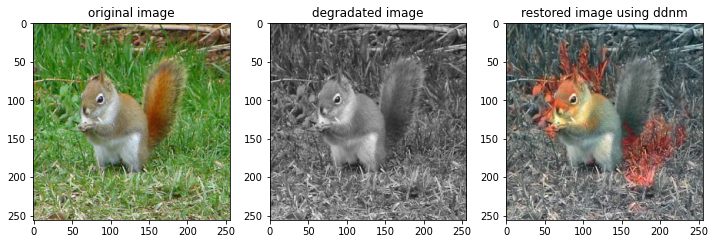

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_col[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




#### Evaluation

As highlighted in the paper, since PSNR and SSIM can not reflect the colorization performance, for this task we have adopted only the FID metric.

In [ ]:
FID = fid(x0_col.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
FID

Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth


  0%|          | 0.00/91.2M [00:00<?, ?B/s]

/usr/local/lib/python3.8/dist-packages/scipy/linalg/_matfuncs_sqrtm.py:186: RuntimeWarning: invalid value encountered in double_scalars
  arg2 = norm(X.dot(X) - A, 'fro')**2 / norm(A, 'fro')


tensor(13.5742)

### DDNM+

Here is applied the DDNM+ algorithm for the colorization task.

In [ ]:
x0_col_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [22:13<00:00,  1.34s/it]


Text(0.5, 1.0, 'restored image using ddnm+')

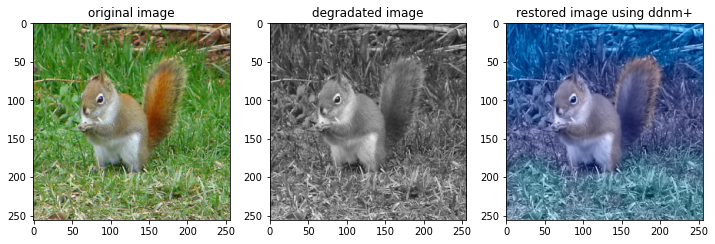

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_col_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on Colorization task for FID metric

In [ ]:
FID = fid(x0_col_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
FID

tensor(25.5534)

## **Inpainting**

Initialization of A, At and y according to the *Inpainting* task

In [ ]:
mask_scoiattolo = (torch.ones(1,256,256)).to(device)
mask_scoiattolo[0,90:120,65:100] = 0

In [ ]:
A,At = choose_task("inpainting",mask=mask_scoiattolo)
y = (A(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Application of the DDNM algorithm on the degradated image for the *inpainting* task

In [ ]:
x0_inp = ddnm(y, A, At)

100%|██████████| 999/999 [03:43<00:00,  4.48it/s]


Text(0.5, 1.0, 'restored image using ddnm')

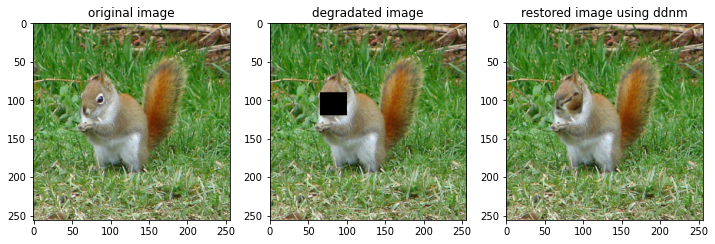

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_inp[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




#### Evaluation

DDNM performance on Inpainting task for PSNR, SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_inp[0].cpu(),transforms(img))
SSIM = ssim(x0_inp.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_inp.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(29.0323), tensor(0.9726), tensor(0.0085))

### DDNM+

Application of the DDNM+ algorithm on the degradated image for the *inpainting* task

In [ ]:
x0_inp_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [22:12<00:00,  1.33s/it]


Text(0.5, 1.0, 'restored image using ddnm+')

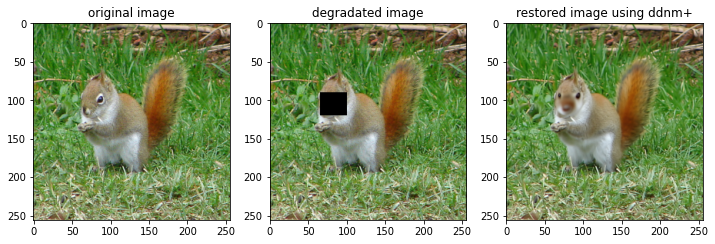

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_inp_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on *Inpainting* task for PSNR, SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_inp_plus[0].cpu(),transforms(img))
SSIM = ssim(x0_inp_plus.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_inp_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(30.4756), tensor(0.9595), tensor(0.6460))

## **Super Resolution**

Initialization of A, At and y according to the *Super Resolution* task

In [ ]:
#variables to perform super resolution using the parameter scale equal to 16
A,At = choose_task("super resolution",scale=16)
y = (A(transforms(img).unsqueeze(0))).to(device)

#variables to perform super resolution using the parameter scale equal to 8
A1,At1 = choose_task("super resolution",scale=8)
y1 = (A1(transforms(img).unsqueeze(0))).to(device)


### DDNM 

Application of the DDNM algorithm on the degradated image for the *Super Resolution* task using a scale equal to 16

In [ ]:
x0_sr = ddnm(y, A, At)

100%|██████████| 999/999 [03:42<00:00,  4.49it/s]


Text(0.5, 1.0, 'restored image using ddnm')

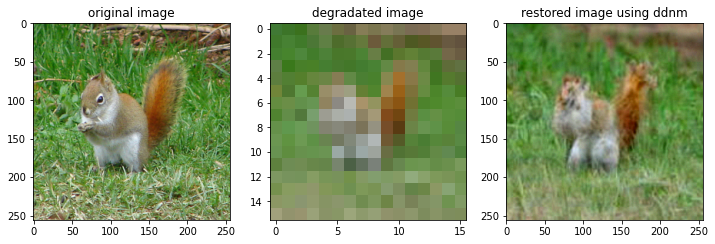

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 

Application of the DDNM algorithm on the degradated image for the *Super Resolution* task using a scale equal to 8

In [ ]:
x0_sr1 = ddnm(y1, A1, At1)

100%|██████████| 999/999 [03:43<00:00,  4.47it/s]


Text(0.5, 1.0, 'restored image using ddnm')

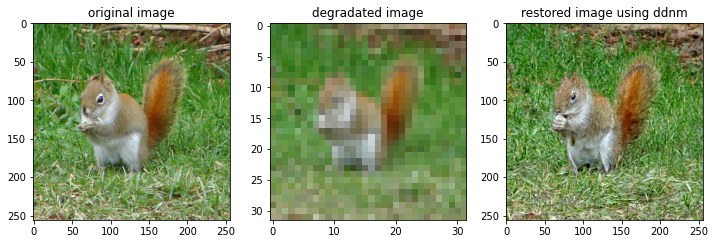

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y1[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr1[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 

#### Evaluation

DDNM performance on *Super Resolution* task (using a scale equal to 16) for PSNR, SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_sr[0].cpu(),transforms(img))
SSIM = ssim(x0_sr.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_sr.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(17.5448), tensor(0.1642), tensor(25.6452))

DDNM performance on *Super Resolution* task (using a scale equal to 8) for PSNR, SSIM and FID metric

In [ ]:
PNSR1 = pnsr(x0_sr1[0].cpu(),transforms(img))
SSIM1 = ssim(x0_sr1.cpu(),transforms(img).unsqueeze(0))
FID1 = fid(x0_sr1.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR1,SSIM1,FID1

(tensor(15.9326), tensor(0.1775), tensor(3.8156))

### DDNM+

Application of the DDNM+ algorithm on the degradated image for the *Super Resolution* task using a scale equal to 16

In [ ]:
x0_sr_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [22:14<00:00,  1.34s/it]


Text(0.5, 1.0, 'restored image using ddnm+')

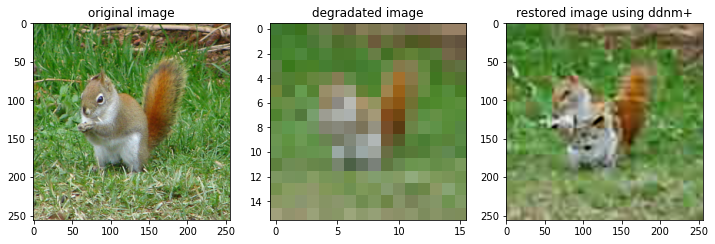

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

Application of the DDNM+ algorithm on the degradated image for the *Super Resolution* task using a scale equal to 8

In [ ]:
x0_sr1_plus = ddnm_plus(y1, A1, At1)

100%|██████████| 999/999 [22:13<00:00,  1.33s/it]


Text(0.5, 1.0, 'restored image using ddnm+')

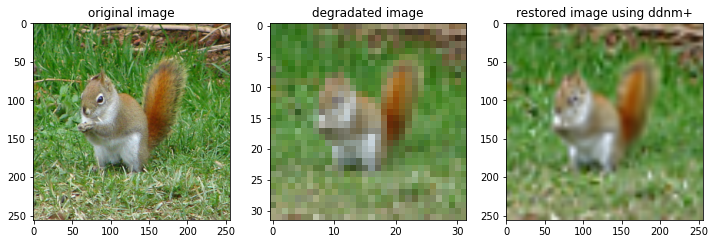

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y1[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_sr1_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on *Super Resolution* task (using a scale equal to 16) for PSNR, SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_sr_plus[0].cpu(),transforms(img))
SSIM = ssim(x0_sr_plus.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_sr_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(17.2337), tensor(0.1914), tensor(41.6410))

DDNM+ performance on *Super Resolution* task (using a scale equal to 8) for PSNR, SSIM and FID metric

In [ ]:
PNSR1 = pnsr(x0_sr1_plus[0].cpu(),transforms(img))
SSIM1 = ssim(x0_sr1_plus.cpu(),transforms(img).unsqueeze(0))
FID1 = fid(x0_sr1_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR1,SSIM1,FID1

(tensor(19.1688), tensor(0.2755), tensor(53.5112))

## **Old Photo Restoration**

Initialization of A, At and y according to the *Old Photo Restoration* task

In [ ]:
mask_scoiattolo = (torch.ones(1,256,256)).to(device)
mask_scoiattolo[0,90:120,65:100] = 0

In [ ]:
A,At = choose_task("old photo restoration",mask=mask_scoiattolo)
y = (A(transforms(img).unsqueeze(0))).to(device)

### DDNM 

Application of the DDNM algorithm on the degradated image for the *Old Photo Restoration* task

In [ ]:
x0_old = ddnm(y, A, At)

100%|██████████| 999/999 [03:44<00:00,  4.44it/s]


Text(0.5, 1.0, 'restored image using ddnm')

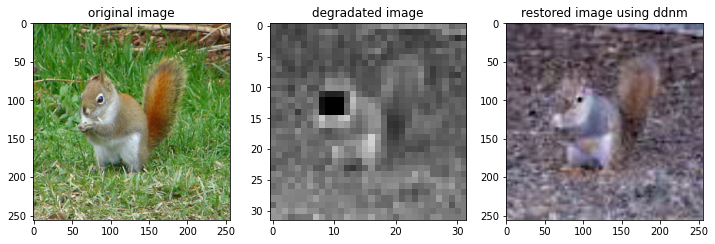

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_old[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm") 




#### Evaluation

DDNM performance on *Old Photo Restoration* task (using a scale equal to 8)  for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_old[0].cpu(),transforms(img))
SSIM = ssim(x0_old.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_old.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(15.5095), tensor(0.2870), tensor(46.0181))

### DDNM+

Application of the DDNM+ algorithm on the degradated image for the *Old Photo Restoration* task

In [ ]:
x0_old_plus = ddnm_plus(y, A, At)

100%|██████████| 999/999 [22:00<00:00,  1.32s/it]


Text(0.5, 1.0, 'restored image using ddnm+')

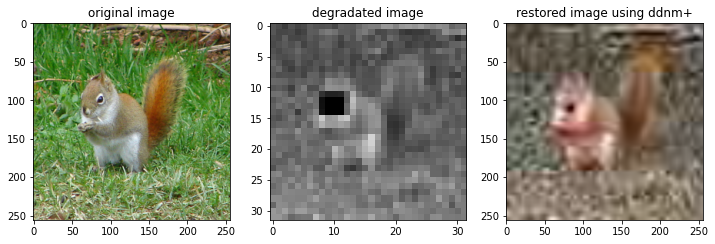

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0_old_plus[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+") 

#### Evaluation

DDNM+ performance on *Old Photo Restoration* task (using a scale equal to 8)  for PSNR,SSIM and FID metric

In [ ]:
PNSR = pnsr(x0_old_plus[0].cpu(),transforms(img))
SSIM = ssim(x0_old_plus.cpu(),transforms(img).unsqueeze(0))
FID = fid(x0_old_plus.cpu().repeat(5,1,1,1),transforms(img).unsqueeze(0).repeat(5,1,1,1))
PNSR,SSIM,FID

(tensor(16.7381), tensor(0.2535), tensor(66.0983))

## **Mask Shift Trick**

The mask shift trick is a technique that allows to restore images with arbitrary size, different from the fixed size 256x256 of the two pretrained models.

To implement this technique we divide the degradated image $y = Ax$ into 8 parts: $[y_0,y_1,\dots,y_7]$; then we take the first two parts $y_0,y_1$ as input of the DDNM algorithm used to super resolution and we get $[x_0,x_1]$.

After that we have 6 runs in which we use $y_i,y_{i+1}$ as input of DDNM at the $i-th$ run, but this time we run a modified version of the algorithm in which we divide the intermediate result $\hat{x}_{0|t}$ into two parts $[\hat{x}_{0|t}^{(left)}, \hat{x}_{0|t}^{(right)} ]$ and we replace the left part of it with the right part of $x_{i-1}$, from the previous iteration.

To build the reconstructed image we concatenate $x_0,\dots,x_7$ to have an image with size bigger than the original one. 

In [ ]:
# use transformation to resize the image and transform to tensor
from torchvision import transforms as Tran
transform_shift = Tran.Compose([
    Tran.Resize((64,256)),
    Tran.ToTensor()
])

In [ ]:
!wget https://raw.githubusercontent.com/wyhuai/DDNM/main/hq_demo/data/datasets/gts/inet256/orange.png

--2023-01-10 19:25:19--  https://raw.githubusercontent.com/wyhuai/DDNM/main/hq_demo/data/datasets/gts/inet256/orange.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 33043 (32K) [image/png]
Saving to: ‘orange.png’

orange.png          100%[===================>]  32.27K  --.-KB/s    in 0s      

2023-01-10 19:25:19 (148 MB/s) - ‘orange.png’ saved [33043/33043]



In the following example we have used an image of oranges with size 64x256, we have degradated it using a scale factor of 4 to get an image of size 16x64 and finally we have used the mask shift trick to obtain an image of size 256x1024

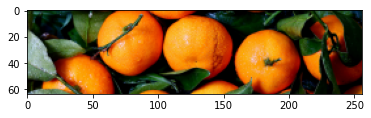

In [ ]:
import matplotlib.pyplot as plt
img = load_image("orange.png")
plt.imshow(transform_shift(img).permute(1,2,0))

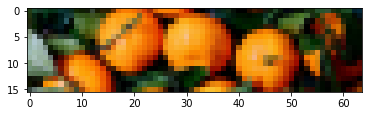

In [ ]:
A,At = choose_task("mask shift trick",scale=4)
y = (A(transforms(img).unsqueeze(0))).to(device)
plt.imshow(y[0].cpu().permute(1,2,0))

In [ ]:
# divide y into 8 parts, each part has a size 16x8
z = torch.zeros((8,1,3,16,8))
for i in range(8):
  z[i] = y[:,:,:,i*8:(i+1)*8]

In [ ]:
# modified version of the algorithm
import tqdm
def ddnm_shift(y, A, At,x_left):
  with torch.no_grad():
    
    x_t = torch.randn((1,3,256,256)).to(device)
    for t in tqdm.tqdm(range(1000,1,-1)):
      timestep = torch.tensor([t]).to(device)
      x0_t = (1/torch.sqrt(alphas[t-1]) * (x_t -  model(x_t,timestep)[:,0:3,:,:] * torch.sqrt(1-alphas[t-1]))).to(device)
      x0_t_est = (x0_t - At(A(x0_t) - y)).to(device)

      x0_t_est = torch.cat([x_left,x0_t_est[:,:,:,128:]],dim=3) # use x_left as left part of x0_t_est
      
      sigma_square = ((1-alphas[t-2]) / (1-alphas[t-1]) * betas[t-1]).to(device)
      eps = torch.randn((1,3,256,256)).to(device)
      x_t = ((torch.sqrt(alphas[t-2]) * betas[t-1] / (1 -alphas[t-1])) * x0_t_est + (torch.sqrt(1-betas[t-1]) * (1-alphas[t-2]) / (1-alphas[t-1])) * x_t + torch.sqrt(sigma_square) * eps).to(device)
  return x_t

In [ ]:
res = torch.zeros((8,1,3,256,128)) # each of the output x_i has a size of 256x128
y_m = (torch.cat([z[0],z[1]],dim=3)).to(device) # use y0 and y1 as input of ddnm
A2,At2 = choose_task("super resolution",scale = 16) # use 16 to have an image 256x256 as output
x_t = (ddnm(y_m,A2,At2)).to(device)
res[0] = x_t[:,:,:,0:128]
res[1] = x_t[:,:,:,128:]
y_m = (torch.cat([z[1],z[2]],dim=3)).to(device)
for j in range(6):
  x_t = ddnm_shift(y_m,A2,At2,x_t[:,:,:,128:])
  res[j+2] = x_t[:,:,:,128:]
  if(j!=5):
    y_m = (torch.cat([z[j+2],z[j+3]],dim=3)).to(device)

100%|██████████| 999/999 [03:46<00:00,  4.42it/s]


In [ ]:
fin = (torch.cat([res[0],res[1],res[2],res[3],res[4],res[5],res[6],res[7]],dim=3)).to(device) # conactenate all the parts to get x

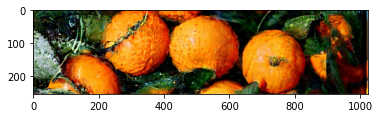

In [ ]:
plt.imshow(fin[0].cpu().permute(1,2,0))

The result has a low quality since we have used the simple version of the algorithm without time travel and we start from a 64x16 degradated image to get a 256x1024 size one, so we have used a 16 scale factor.

# **Evaluation**


We performed the tasks on 12 images both using the DDNM algorithm and  the DDNM+ one (7 images from the test set of CelebA and 5 images from the test set of ImageNet). Depending on the task we evaluated, for each image we computed the related metrics defined at the beginning of the notebook; so we compared for each task, the results obtained on the reconstructed image by using the DDNM algorithm and the ones obtained on the reconstructed image by using the DDNM+ algorithm.
Next for each task we will show first the results obtained on the images of CelebA and then the results obtained on the images of ImageNet.

We set the parametrs 𝜎𝑦 and l (parametrs of DDNM+) respectively to 0.1 and 5.


##Colorization


For the colorization task we used the metric FID. Notice that the lower the score is, the more similar the images are. 

### CelebA

In the following table we show in each row: the original image we used, the degradated image, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

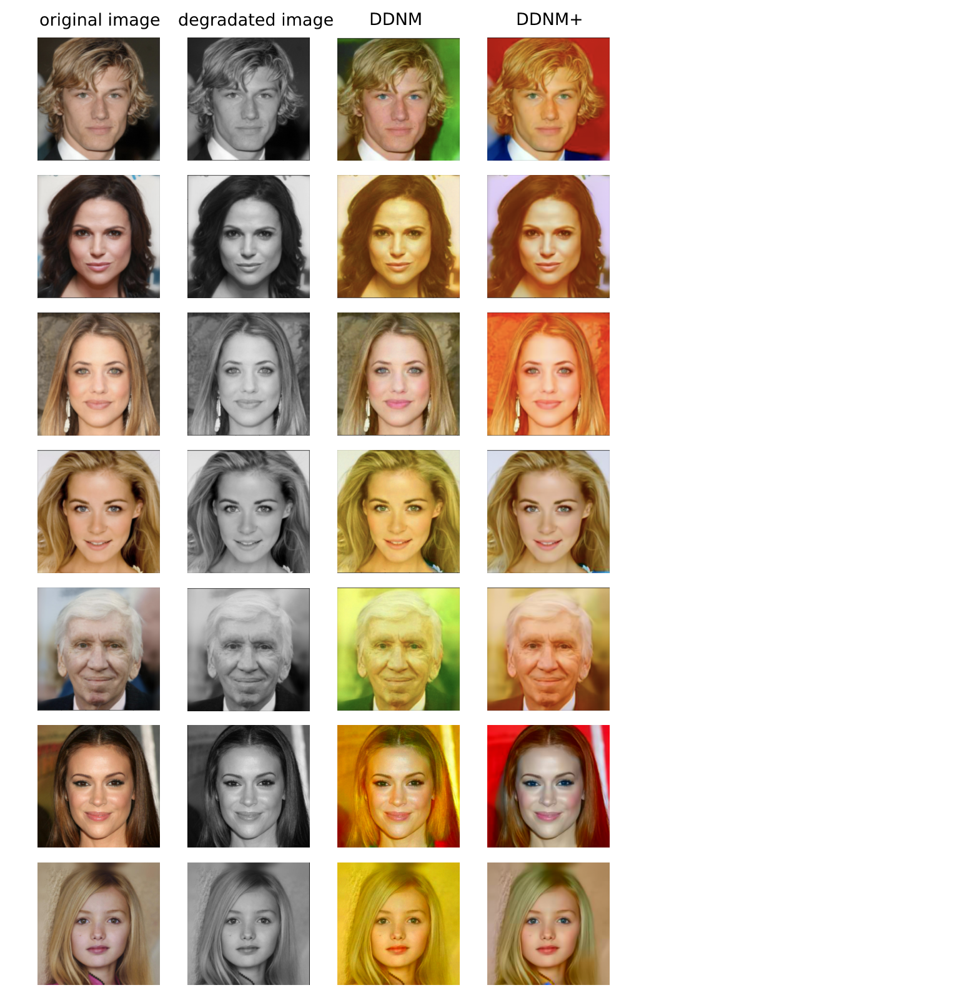

In the next table we show the results obtained by using the metric FID between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM      | DDNM+     |
|------|-----------|-----------|
|      | FID       | FID       |
| img1 | **18.86** | 31.89     |
| img2 | 16.46     | **15.36** |
| img3 | **2.18**  | 97.82     |
| img4 | 32.11     | **14.01** |
| img5 | 20.12     | **7.31**  |
| img6 | **15.17** | 27.58     |
| img7 | 21.20     | **1.23**  |

As we can see from the results obtained, there is not a best algorithm to choose to perform the colorization task. Indeed DDNM performs better on: img1, img3 and img6; while DDNM+ performs better on: img2, img4, img5 and img6. So it is better to use DDNM to achieve this task since the time needed to run its algorithm is much lesser than the one needed for the DDNM+ algorithm.

### ImageNet


In the following table we show in each row: the original image we used, the degradated image, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

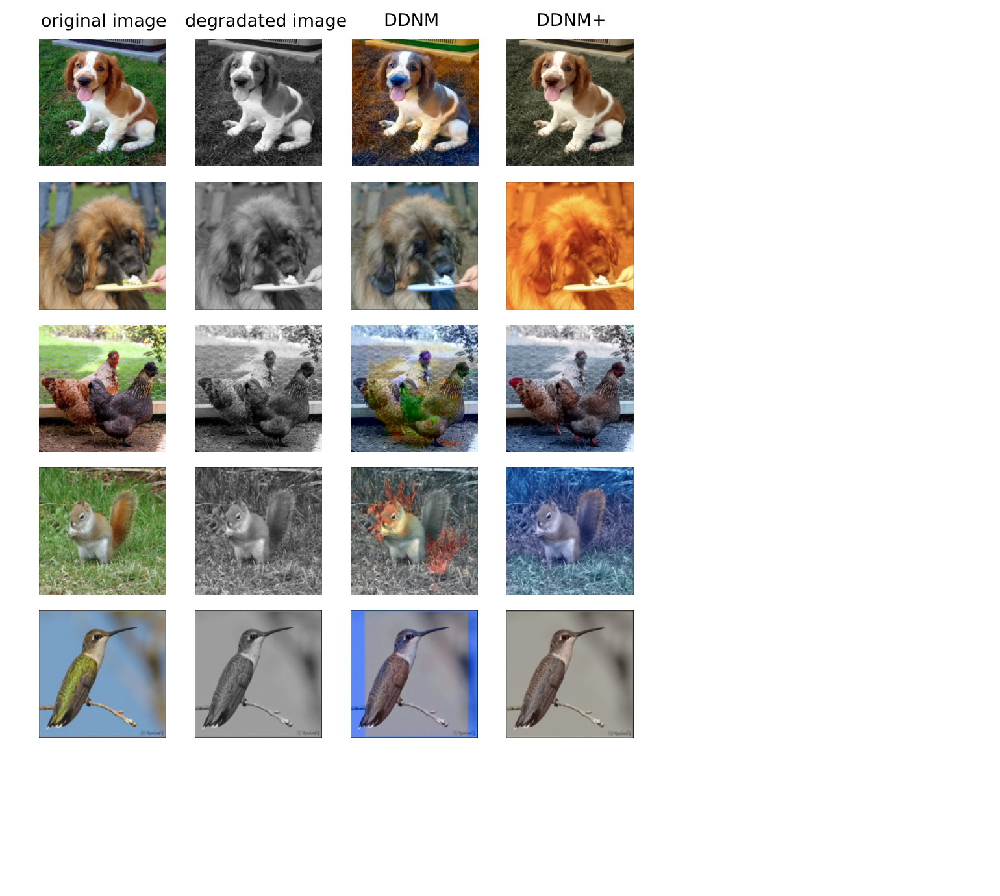

In the next table we show the results obtained by using the metric FID between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM      | DDNM+    |
|------|-----------|----------|
|      | FID       | FID      |
| img1 | 6.86      | **3.73** |
| img2 | **2.20**  | 44.07    |
| img3 | **8.07**  | 8.08     |
| img4 | **13.57** | 25.55    |
| img5 | 5.58      | **5.18** |

Also for ImageNet there are some images on which the DDNM performs better than DDNM+ and other images on which the opposite happens. The reconstructed images that are better by using DDNM are: img2, img3 and img4; the reconstructed images that are better by using DDNM+ are: img1 and img5.

## Inpainting


For the inpainting task we used all the metrics we defined: PSNR, SSIM, FID. Notice that the lower the score of FID is, the more similar the images are, while for SSIM and PSNR is the opposite.

### CelebA


In the following table we show in each row: the original image we used, the degradated image, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

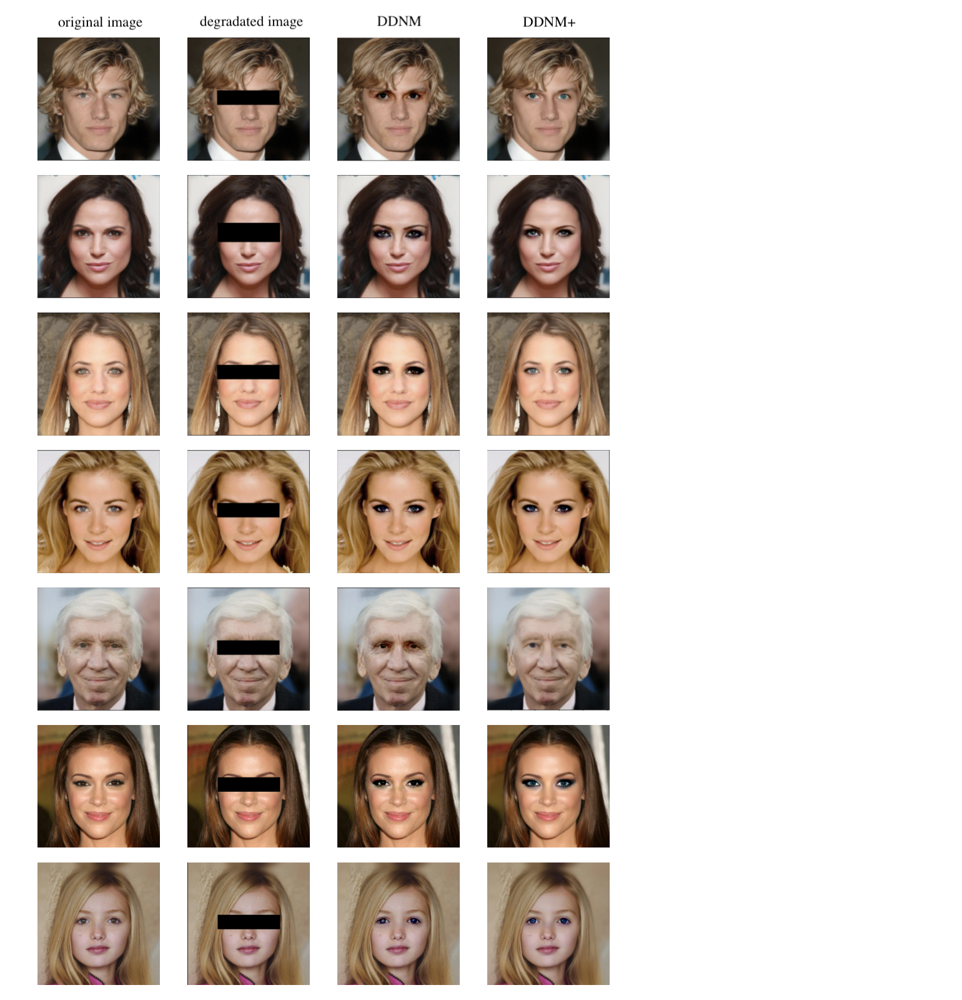

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                    | DDNM+                       |
|------|-------------------------|-----------------------------|
|      | PSNR / SSIM / FID       | PSNR / SSIM / FID           |
| img1 | 25.76 / 0.93 / 2.26     | **31.39 / 0.94 / 0.42**     |
| img2 | 26.50 / 0.91 /0.73      | **29.94 / 0.94 / 0.28**     |
| img3 | 23.74 / **0.95** / 1.99 | **32.34** / 0.94 / **0.52** |
| img4 | 25.80 / **0.95** / 1.97 | **26.62** / 0.94 / **1.37** |
| img5 | 29.30 / 0.93 / 0.90     | **31.80 / 0.94 / 0.66**     |
| img6 | **29.21 / 0.95** / 1.35 | 29.09 / 0.94 / **0.30**     |
| img7 | 30.96 / 0.95 / 0.54     | **32.24 / 0.96 / 0.37**     |

For this particular task we can see that the algorithm that performs better results is the DDNM+. Indeed almost every time the metrics PSNR and FID are better than the ones computed by using DDNM; SSIM is  almost equal between the two algorithms for each image.

### ImageNet

In the following table we show in each row: the original image we used, the degradated image, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

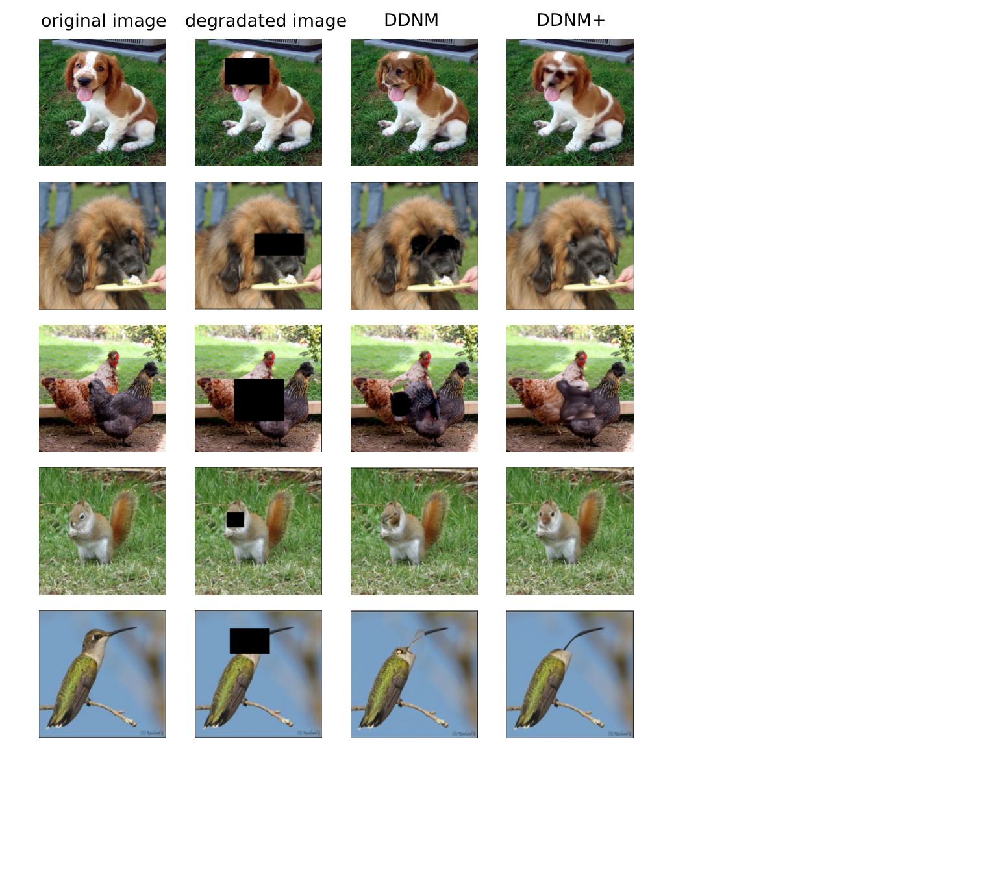

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                    | DDNM+                   |
|------|-------------------------|-------------------------|
|      | PSNR / SSID / FID       | PSNR / SSID / FID       |
| img1 | 21.09 / **0.91 / 0.38** | **21.27 / 0.91** / 0.99 |
| img2 | 22.58 / 0.90 / **1.22** | **26.35 / 0.91** / 1.80 |
| img3 | 19.95 / **0.87** / 5.32 | **23.07 / 0.87 / 1.55** |
| img4 | 29.03 / **0.97 / 0.01** | **30.48** / 0.96 / 0.65 |
| img5 | **24.31** / 0.91 / 0.69 | 23.95 / **0.95 / 0.45** |

For the inpainting task we have that the PSNR value computed by using the reconstructed image with DDNM+ is mostly better that the one computed on the image reconstructed with DDNM. For the other two metrics we don't get well defined results to state which of the two algoritms perform better.

## Super Resolution


For the super resolution task we used all the metrics we defined: PSNR, SSIM, FID. Notice that the lower the score of FID is, the more similar the images are; While for SSIM and PSNR is the opposite.

We performed two test for each image: one test by using the parameter "scale" equal to 8 and another one by using the parameter equal to 16 (the higher the scale parameter is, the more degraded the image is)

### CelebA


#### Super Resolution with scale=8

In the following table we show in each row: the original image we used, the degradated image by using scale=8, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

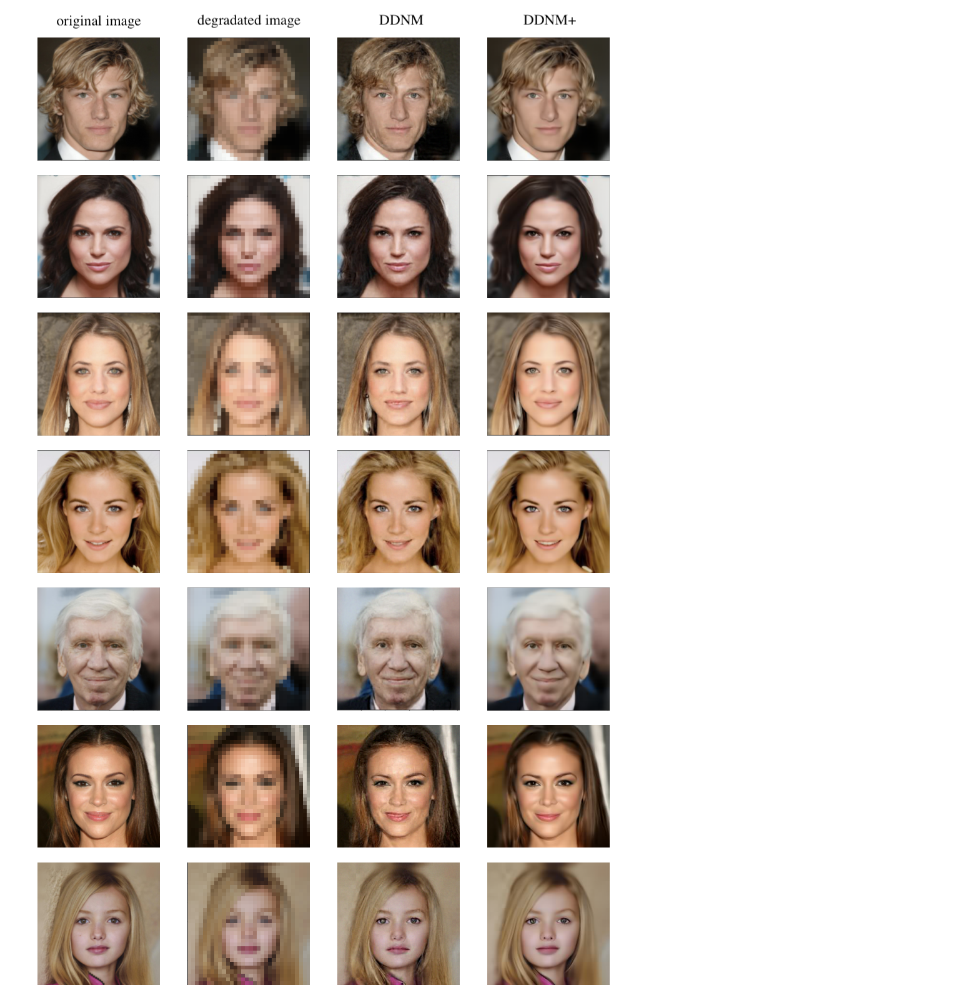

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                    | DDNM+                   |
|------|-------------------------|-------------------------|
|      | PSNR / SSIM / FID       | PSNR / SSIM / FID       |
| img1 | 23.50 / 0.58 / 5.88     | **24.66 / 0.68 / 0.74** |
| img2 | 26.12 / 0.73 / 2.92     | **27.81 / 0.85 / 0.60** |
| img3 | 22.94 / 0.65 / 3.80     | **23.92 / 0.72 / 1.09** |
| img4 | 23.53 / 0.64 / 7.94     | **24.97 / 0.74 / 4.47** |
| img5 | 26.16 / 0.75 / **1.35** | **28.81 / 0.85** / 1.50 |
| img6 | 25.50 / 0.66 / 7.78     | **27.75 / 0.78 / 1.23** |
| img7 | 26.11 / 0.71 / **0.73**     | **29.22 / 0.82 /** 1.36 |

#### Super Resolution with scale=16

In the following table we show in each row: the original image we used, the degradated image using scale=16, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

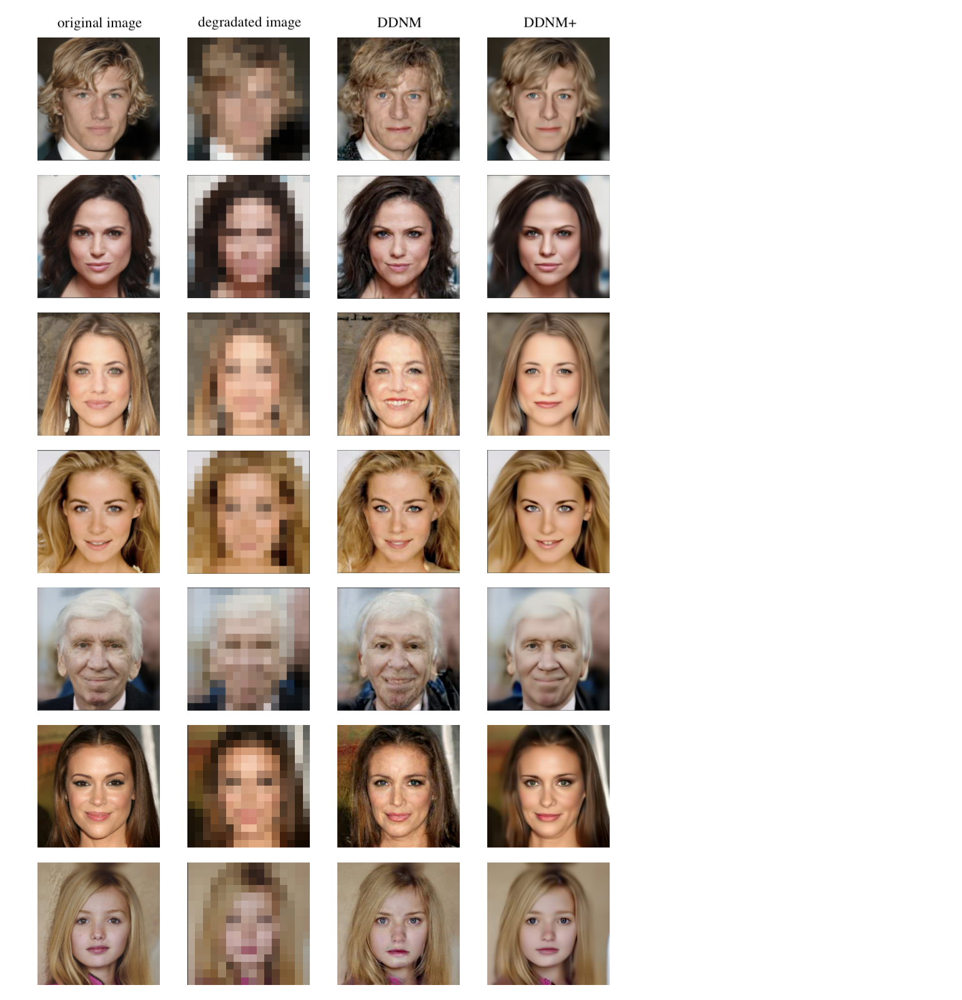

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                    | DDNM+                   |
|------|-------------------------|-------------------------|
|      | PSNR / SSIM / FID       | PSNR / SSIM / FID       |
| img1 | 20.50 / 0.49 / 8.02     | **21.62 / 0.60 / 1.33** |
| img2 | 21.93 / 0.60 / 12.48    | **24.09 / 0.77 / 0.53** |
| img3 | 19.62 / 0.57 / 6.75     | **22.09 / 0.64 / 2.10** |
| img4 | 19.98 / 0.56 / 9.87     | **21.16 / 0.64 / 3.89** |
| img5 | 20.36 / 0.61 / 3.97     | **24.35 / 0.79 / 0.89** |
| img6 | 22.29 / 0.56 / 10.24    | **23.16 / 0.66 / 1.63** |
| img7 | 21.83 / 0.59 / **1.01** | **22.93 / 0.72** / 1.38 |

#### Conlusion

For both the tests (scale=8 and scale=16), the super resolution task is performed better by using the DDNM+ algorithm. 

### ImageNet


#### Super Resolution with scale=8

In the following table we show in each row: the original image we used, the degradated image using scale=8, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

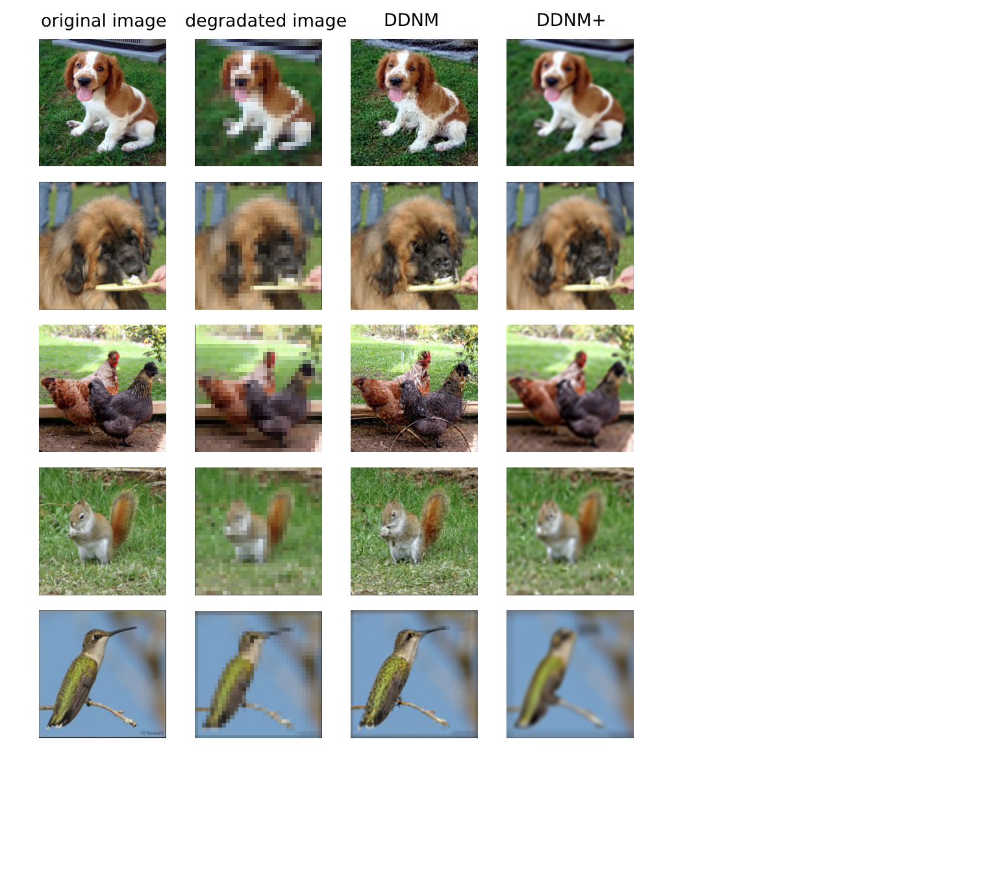

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                    | DDNM+                    |
|------|-------------------------|--------------------------|
|      | PSNR / SSID / FID       | PSNR / SSID / FID        |
| img1 | 19.44 / 0.38 / **9.66** | **23.28 / 0.54** / 26.55 |
| img2 | 23.35 / 0.57 / **0.54** | **25.99 / 0.70** / 8.34  |
| img3 | 16.75 / 0.22 / 35.02    | **20.97 / 0.44 / 28.33** |
| img4 | 15.93 / 0.18 / **3.81** | **19.17 / 0.28** / 53.51 |
| img5 | 20.34 / 0.77 / **0.55** | **21.23 / 0.84** / 3.35  |

#### Super Resolution with scale=16

In the following table we show in each row: the original image we used, the degradated image using scale=16, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

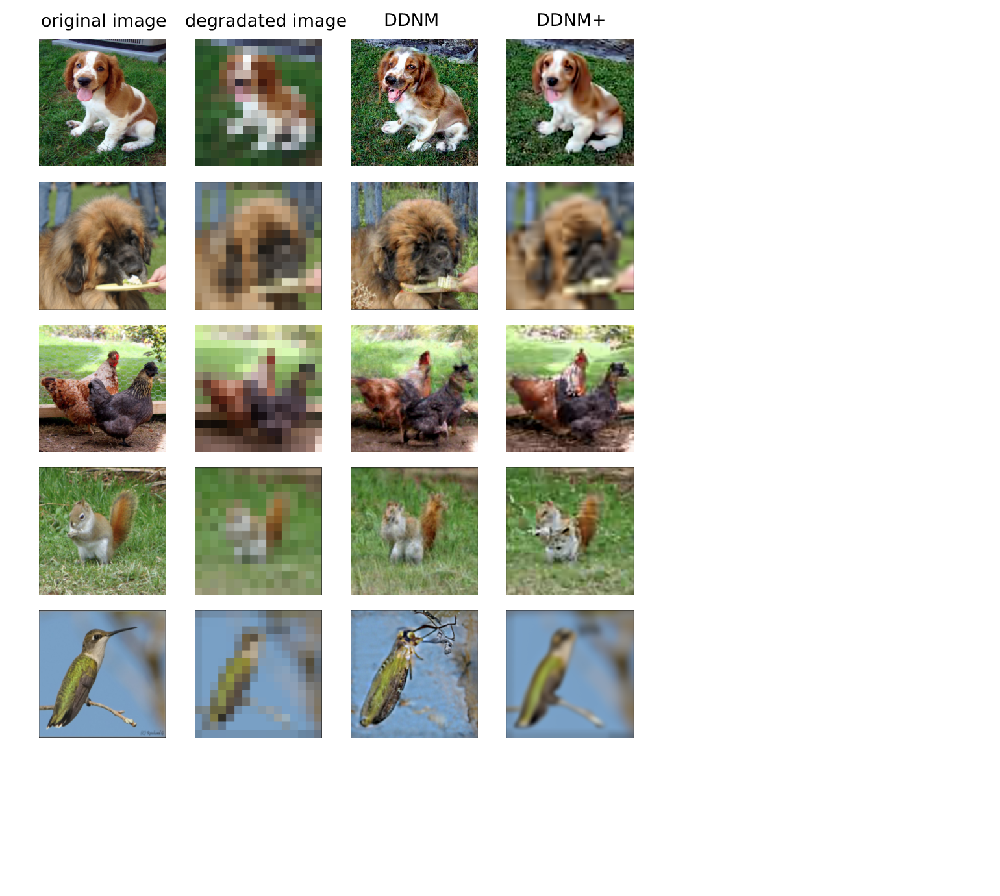

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                         | DDNM+                     |
|------|------------------------------|---------------------------|
|      | PSNR / SSID / FID            | PSNR / SSID / FID         |
| img1 | 14.12 / 0.20 / 60.85         | **17.03 / 0.33 / 6.58**   |
| img2 | 19.02 / 0.37 / **4.20**      | **20.87 / 0.52** / 12.57  |
| img3 | 17.50 / 0.27 / **2.71**          | **17.51 /0.29** / 13.09   |
| img4 | **17.54** / 0.16 / **25.65** | 17.23 / **0.19** / 41.64  |
| img5 | 16.58 / 0.63 / **4.62**      | **19.70 / 0.77** / 5.80   |

#### Conlusion

Except for the metric FID, for both the tests (SR with scale=8 and SR with scale=16) we have better results by using DDNM+ than DDNM.

## Old Photo Restoration


For the old photo restoration task we used all the metrics we defined: PSNR, SSIM, FID. Notice that the lower the score of FID is, the more similar the images are; While for SSIM and PSNR is the opposite.

We used the parameter "scale" equal to 8 for all the images.

### CelebA


In the following table we show in each row: the original image we used, the degradated image, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

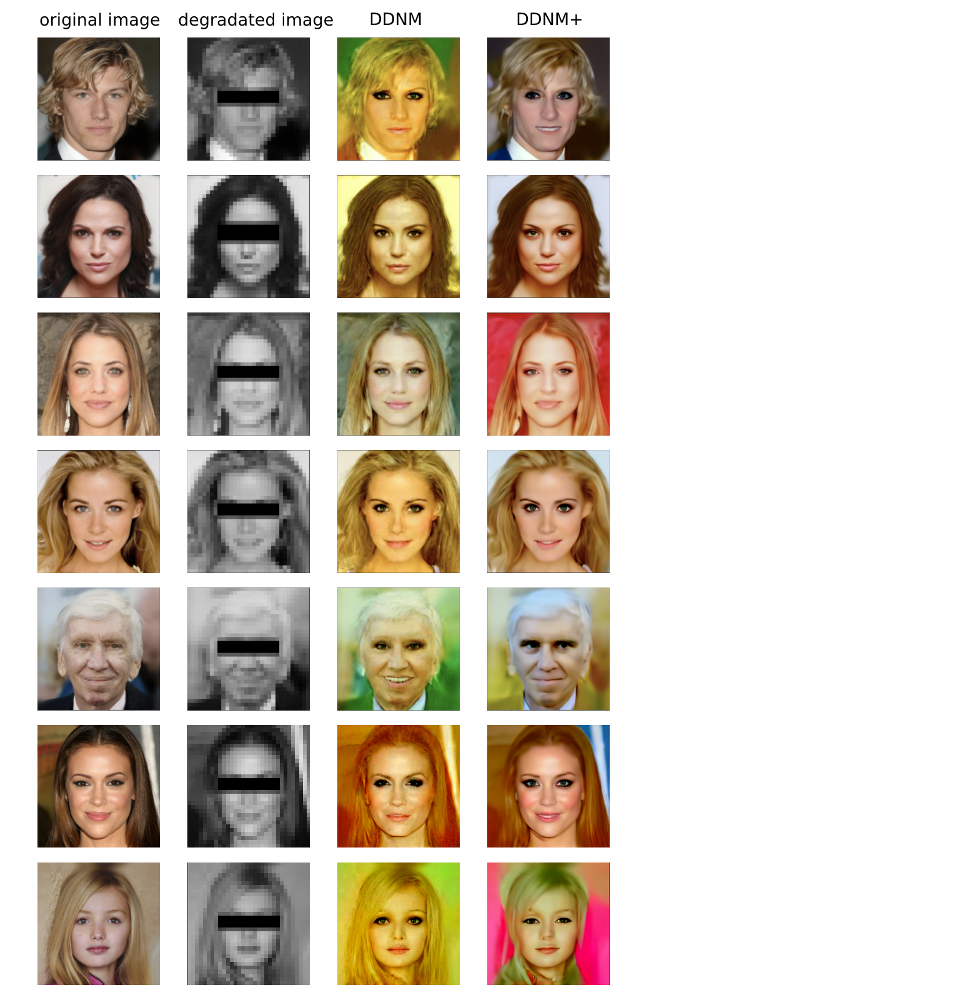

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                     | DDNM+                    |
|------|--------------------------|--------------------------|
|      | PSNR / SSIM / FID        | PSNR / SSIM / FID        |
| img1 | 10.07 / 0.45 / 36.01     | **20.25 / 0.63 / 4.35**  |
| img2 | 12.69 / 0.46 / 43.59     | **17.99 / 0.58 / 22.68** |
| img3 | **20.13 / 0.65 / 5.62**  | 14.55 / 0.63 / 12.80     |
| img4 | 16.66 / 0.58 / 50.71     | **20.07 / 0.71 / 11.97** |
| img5 | **14.79** / 0.66 / 12.39 | 11.64 / **0.74 / 3.22**  |
| img6 | 11.42 / 0.49 / 18.05     | **15.32 / 0.58 / 16.53** |
| img7 | 10.25 / 0.55 / 26.77     | **12.57 / 0.74 / 7.01**  |

Also in this case DDNM+ performs better than DDNM. Indeed only one image over seven is better reconstructed by using the DDNM algorithm.

### ImageNet

In the following table we show in each row: the original image we used, the degradated image, the reconstructed image by using DDNM, the reconstructed image by using DDNM+.

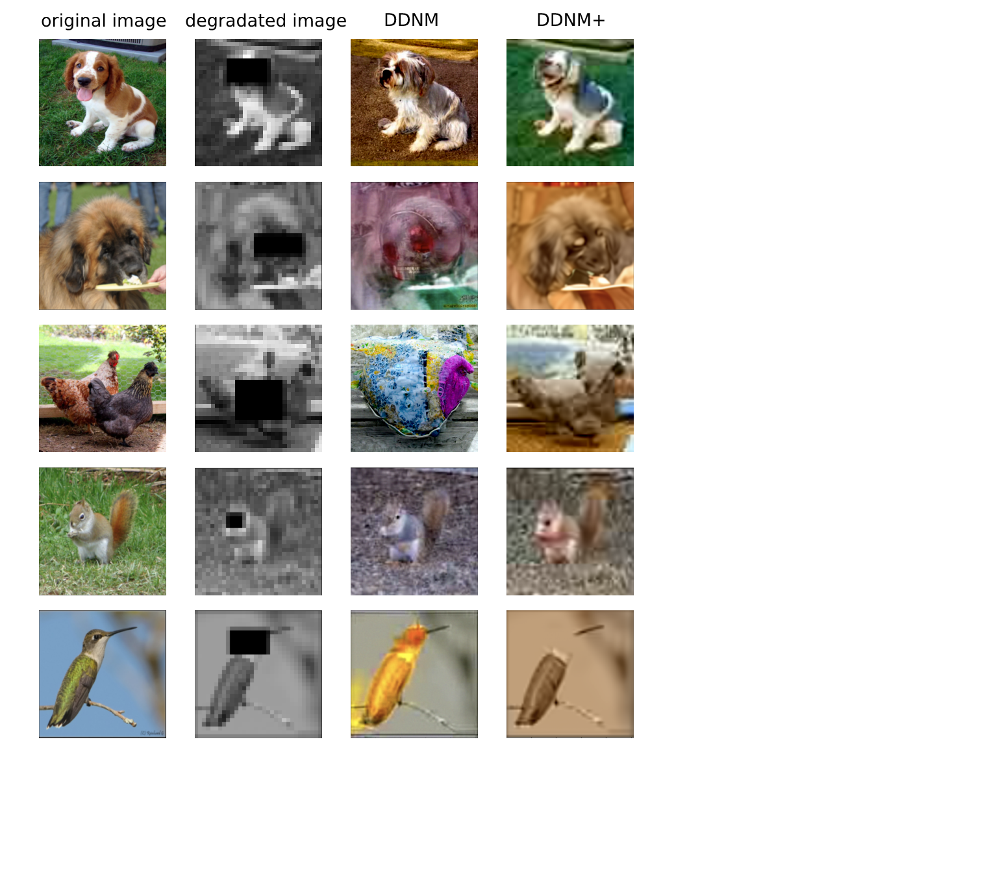

In the next table we show the results obtained by using the metrics between the original image and the reconstructed one (in the first colum we consider the reconstructed image by using DDNM, in the second column we consider the one reconstructed by using DDNM+). The order of the rows is the same as the previous table.

|      | DDNM                        | DDNM+                    |
|------|-----------------------------|--------------------------|
|      | PSNR / SSID / FID           | PSNR / SSID / FID        |
| img1 | 13.04 / 0.34 / 30.66        | **17.03 / 0.45 / 16.37** |
| img2 | **16.57** / 0.57 / **5.86** | 14.79 / **0.60** / 10.46 |
| img3 | 12.79 / 0.27 / 26.75        | **16.55 / 0.39 / 19.01** |
| img4 | 15.51 / **0.29 / 46.02**    | **16.74** / 0.25 / 66.10 |
| img5 | 11.11 / 0.68 / **9.12**     | **12.18 / 0.73** / 24.04 |

Also for this task we have that the metrics PSNR and SSIM are better by using DDNM+ than DDNM; for the metric FID we have 3 images on which its value it is better by using DDNM and two images on which its value is better by using DDNM+.

# **Our simple model**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

**DOUBLECONV**


This model consists in a first convolution layer, a Batch Normalization layer, a ReLU, another convolution layer and finally a Batch Normalization layer followed by another ReLU.

In [ ]:
class DoubleConv(nn.Module):
  def __init__(self, in_channel, out_channel):
    super().__init__()
    self.conv1 = nn.Conv2d(in_channel, out_channel, 3, padding=1)
    self.norm1 = nn.BatchNorm2d(out_channel)
    self.conv2 = nn.Conv2d(out_channel, out_channel, 3, padding=1)
    self.norm2 = nn.BatchNorm2d(out_channel)

  def forward(self, x):
    x = self.conv1(x)
    x = self.norm1(x)
    x = F.relu(x)
    x = self.conv2(x)
    x = self.norm2(x)
    x = F.relu(x)
    return x

**DOWNSAMPLE**

Downscaling of the image is done for various reasons like:
*   It makes the data of a more manageable size
*   Reduces the dimensionality of the data thus enabling in faster processing of the data (image)
* Reducing the storage size of the data


So it aims essentially to throw away some of the (non-essential) information, using for example the Max Pooling layer like in the model below.

In [ ]:
class DownSample(nn.Module):
  def __init__(self, in_channel, out_channel,emb_dim=1000):
    super().__init__()
    self.pool = nn.MaxPool2d(2)
    self.conv1 = DoubleConv(in_channel, in_channel)
    self.conv2 = DoubleConv(in_channel, out_channel)
    self.emb_layer = nn.Sequential(
      nn.SiLU(),
      nn.Linear(emb_dim, out_channel))

  def forward(self, x,t):
    x = self.pool(x)
    x = self.conv1(x)
    x = self.conv2(x)
    emb = self.emb_layer(t)[:, :, None, None].repeat(1, 1, x.shape[-2], x.shape[-1])
    return x + emb



**UPSAMPLE**


Aims at increasing the number of rows and/or columns (dimensions) of the image. One approach could be to just repeat each column/row in the original image, but in this way it does not provide any new information.
So a good approach is to **interpolate** the new data between the rows/columns which provide a reasonably accurate intermediate value using some advanced mathematical produces. Indeed in the forward pass, we have applied an interpolation and two convolutional layers on the input. Then the result is summed with another linear layer where has been applied the SiLU activation function.

In [ ]:
class UpSample(nn.Module):
  def __init__(self, in_channel, out_channel,emb_dim=1000):
    super().__init__()
    self.conv1 = DoubleConv(in_channel, in_channel)
    self.conv2 = DoubleConv(in_channel, out_channel)
    self.emb_layer = nn.Sequential(
      nn.SiLU(),
      nn.Linear(emb_dim, out_channel))

  def forward(self, x1, x2, t):
    x1 = nn.functional.interpolate(x1, scale_factor=2.0, mode="bilinear")
    x1 = torch.cat([x2,x1],dim=1)
    x1 = self.conv1(x1)
    x1 = self.conv2(x1)
    emb = self.emb_layer(t)[:, :, None, None].repeat(1, 1, x1.shape[-2], x1.shape[-1])
    return x1 +emb

**SIMPLE UNET**


The network consists of a contracting path and an expansive path, which gives it the u-shaped architecture.

Here is shown the structure of our UNet model that consists of:

*   Two convolutional layers
*   Three [DownSample](#scrollTo=Y4EEJDvjQPtK)
*   Four convolutional layers
*   Three [UpSample](#scrollTo=RBhQIqRPvOIY)
*   One convolutional layer



In [ ]:
class SimpleUNet(nn.Module):
  def __init__(self, in_channel=3, out_channel=3, timestep=1000):
    super().__init__()
    
    self.timestep = timestep
    self.inp = DoubleConv(in_channel, 64)

    self.down1 = DownSample(64, 128)
    self.down2 = DownSample(128, 256)
    self.down3 = DownSample(256, 256)

    self.dc1 = DoubleConv(256, 256) 
    self.dc2 = DoubleConv(256, 256)

    self.up1 = UpSample(512, 128)
    self.up2 = UpSample(256, 64)
    self.up3 = UpSample(128, 64) 

    self.out = nn.Conv2d(64, out_channel, kernel_size=1)
    
  def forward(self, x, t):
    t = self.timestep_embedding(t.unsqueeze(0), self.timestep)

    x1 = self.inp(x) # shape (1,64,256,256)
    x2 = self.down1(x1, t) # shape (1,128,128,128)
    x3 = self.down2(x2, t) # shape (1,256,64,64)
    x4 = self.down3(x3, t) # shape (1,256,32,32)
    
    x4 = self.dc1(x4) # shape (1,256,32,32)
    x4 = self.dc2(x4) # shape (1,256,32,32)
    
    x = self.up1(x4, x3, t) # shape (1,128,64,64)
    x = self.up2(x, x2, t) # shape (1,64,128,128)
    x = self.up3(x, x1, t) # shape (1,64,256,256)
    
    x = self.out(x) # shape (1,3,256,256)
    return x

  # this function is taken from https://github.com/tcapelle/Diffusion-Models-pytorch/blob/main/modules.py
  #Builds sinusoidal embeddings in order to add a sinusoidal position embedding into each residual block.
  def timestep_embedding(self, t, channels):
    inv_freq = 1.0 / (10000 ** (torch.arange(0, channels, 2,device=device).float() / channels))
    pos_enc_a = torch.sin(t.repeat(1, channels // 2) * inv_freq)
    pos_enc_b = torch.cos(t.repeat(1, channels // 2) * inv_freq)
    pos_enc = torch.cat([pos_enc_a, pos_enc_b], dim=-1)
    return pos_enc

In [ ]:
import torch
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
model = SimpleUNet().to(device)

In [ ]:
import numpy as np
betas = torch.tensor(np.linspace(0.0001, 0.02, 1000, dtype=np.float64)).to(device)
alphas = torch.cumprod(1 - betas, dim=0).to(device)

The training phase has been performed using the images in the directory "celeba_hq.zip" that has been added
to our Drive. If you want to perform this training phase, you have to add it in your Drive folder, download the zip file and extract all the images in order to execute the training. Except for loading the dataset in your Drive folder, the other commands are the commented ones below. If you want to test our trained model skip the training part and load our checkpoint ([go here](#scrollTo=DMrVCRA0GWhq)).

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#from zipfile import ZipFile
#with ZipFile('./drive/My Drive/celeba_hq.zip', 'r') as zipObj:
#   zipObj.extractall()

In [ ]:

train = []
for i in range(200,1000):
  path = "celeba/00"+str(i)+".png"
  img = load_image(path)
  train.append(img)
for i in range(1000,1200):
  path = "celeba/0"+str(i)+".png"
  img = load_image(path)
  train.append(img)

In [ ]:
import random
def loss(x0):
  T = 1000
  t = random.randint(0,T-1)
  eps = torch.randn((1,3,256,256)).to(device)
  res = torch.sqrt(alphas[t]).to(device) * x0 + torch.sqrt(1-alphas[t]).to(device) * eps
  return torch.norm(eps-model(res,torch.tensor([t]).to(device))) ** 2

In [ ]:
import tqdm
opt = torch.optim.Adam(model.parameters())

model.train()

for epoch in tqdm.tqdm(range(10)):
  l = 0
  opt.zero_grad()
  for i in range(len(train)):
    x0 = transforms(train[i]).unsqueeze(0).to(device)
    l += loss(x0)
  l.backward()
  opt.step()
  

100%|██████████| 10/10 [19:03<00:00, 114.38s/it]


This is the checkpoint to load our trained model.

In [ ]:
!wget https://raw.githubusercontent.com/cesto99/NNProject/a3d4a6bcd90aab0bb7211829aaa82e354958a1ea/my_model.pt

In [ ]:
checkpoint3 = torch.load("./my_model.pt")
model.load_state_dict(checkpoint3['model_state_dict'])

<All keys matched successfully>

In [ ]:
!wget https://raw.githubusercontent.com/cesto99/NNProject/fa03e7811a290a541c38712a3fb97a29411aaf39/images_for_evaluation/man_3.png

--2023-01-10 18:50:53--  https://raw.githubusercontent.com/cesto99/NNProject/fa03e7811a290a541c38712a3fb97a29411aaf39/images_for_evaluation/man_3.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1638689 (1.6M) [image/png]
Saving to: ‘man_3.png’

man_3.png           100%[===================>]   1.56M  --.-KB/s    in 0.02s   

2023-01-10 18:50:54 (78.6 MB/s) - ‘man_3.png’ saved [1638689/1638689]



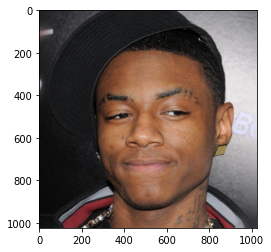

In [ ]:
import matplotlib.pyplot as plt
img = load_image("man_3.png")
plt.imshow(img)

In [ ]:
A,At = choose_task("super resolution",scale=8)
y = (A(transforms(img).unsqueeze(0))).to(device)

In [ ]:
x0 = ddnm_plus(y,A,At)

100%|██████████| 999/999 [03:52<00:00,  4.30it/s]


Text(0.5, 1.0, 'restored image using ddnm+')

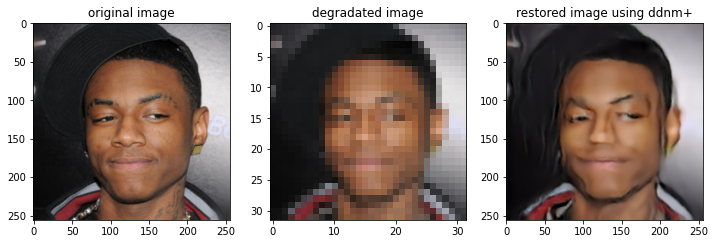

In [ ]:
f, axarr = plt.subplots(1,3,figsize=(12, 12))
axarr[0].imshow(transforms(img).permute(1,2,0))
axarr[0].set_title("original image") 
axarr[1].imshow(y[0].cpu().permute(1,2,0))
axarr[1].set_title("degradated image") 
axarr[2].imshow(x0[0].cpu().permute(1,2,0))
axarr[2].set_title("restored image using ddnm+")